# UMAPs Neurips samples, NK cells

In this notebook different markers to identify NK cell subpopulations are tested. Markers are collected from Melsen et al., paper (2022). RNA and corresponding surface markers are shown when available. Protein expression levels within a cell are normalized using the centered-log ratio (CLR) transformation. UMAPs are generated using latent space representation of measured RNA and surface protein data.  

Reference: 
Melsen, J. E., van Ostaijen-Ten Dam, M. M., Schoorl, D. J. A., Schol, P. J., van den Homberg, D. A. L., Lankester, A. C., Lugthart, G., & Schilham, M. W. (2022). Single-cell transcriptomics in bone marrow delineates CD56dimGranzymeK+ subset as intermediate stage in NK cell differentiation. Frontiers in immunology, 13, 1044398. https://doi.org/10.3389/fimmu.2022.1044398

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import anndata as ad
import scvi
import scanpy as sc
import umap

from ridgeplot import ridgeplot

import warnings

warnings.filterwarnings('ignore')



Global seed set to 0
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


In [2]:
#Neurips
adata = sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/adata_neurips_norm_outer.h5ad')

In [3]:
adata_nk = adata[(adata.obs['cell_type'] == "NK") | (adata.obs['cell_type'] == "NK CD158e1+")] 
                            
adata_nk

View of AnnData object with n_obs × n_vars = 7388 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [4]:
#protein infromation for selected subset
prot=adata_nk.obsm['protein_expression_clr_neurips']

In [5]:
#some proteins and genes have same names, here _prot added after protein names
prot=prot.rename(columns={'CD2': 'CD2_prot', 'CD69': 'CD69_prot', 'CX3CR1': 'CX3CR1_prot', 'CD226':'CD226_prot', 'TIGIT':'TIGIT_prot', 'CD27':'CD27_prot', 'CD34': 'CD34_prot', 'CD38': 'CD38_prot', 'CD224': 'CD224_prot', 'CD7': 'CD7_prot', 'CD44': 'CD44_prot', 'CD5': 'CD5_prot'})


#adding protein information to obs

a = adata_nk.obs
b = prot

df=pd.concat([a, b], axis=1)
adata_nk.obs=df

In [6]:
adata_nk

AnnData object with n_obs × n_vars = 7388 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS', 'CD86', 'CD274', 'CD270', 'CD155', 'CD112', 'CD47', 'CD48', 'CD40', 'CD154', 'CD52', 'CD3', 'CD8', 'CD56', 'CD19', 'CD33', 'CD11c', 'HLA-A-B-C', 'CD45RA', 'CD123', 'CD7_prot', 'CD105', 'CD49f', 'CD194', 'CD4', 'CD44_prot', 'CD14', 'CD16', 'CD25',

In [7]:
#Computing a neighborhood of observations using latent space

sc.pp.neighbors(adata_nk, use_rep="X_totalVI")   

sc.tl.umap(adata_nk)

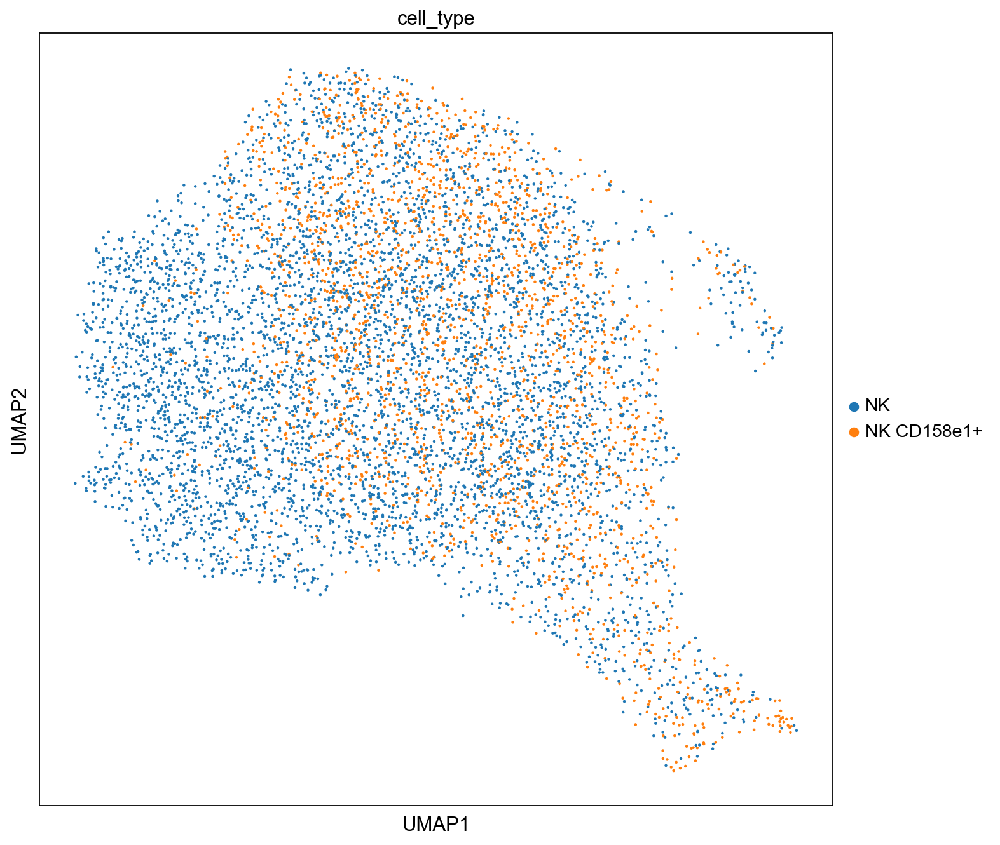

In [8]:
# Selected cells cells from Neurips dataset

sc.set_figure_params(figsize=(10, 10))

sc.pl.umap(adata_nk, color = ['cell_type'], color_map = 'viridis')

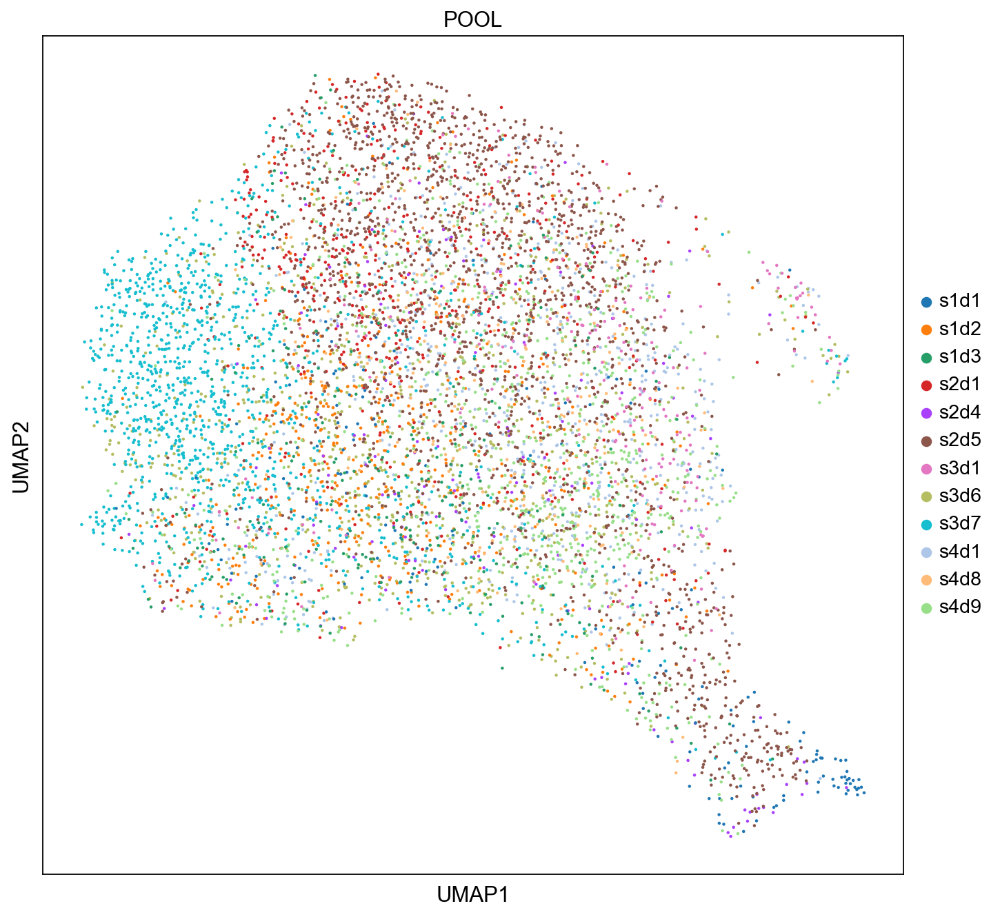

In [9]:
# Selected cells cells from Neurips dataset, coloured by samples

sc.set_figure_params(figsize=(10, 10))

sc.pl.umap(adata_nk, color = ['POOL'], color_map = 'viridis')

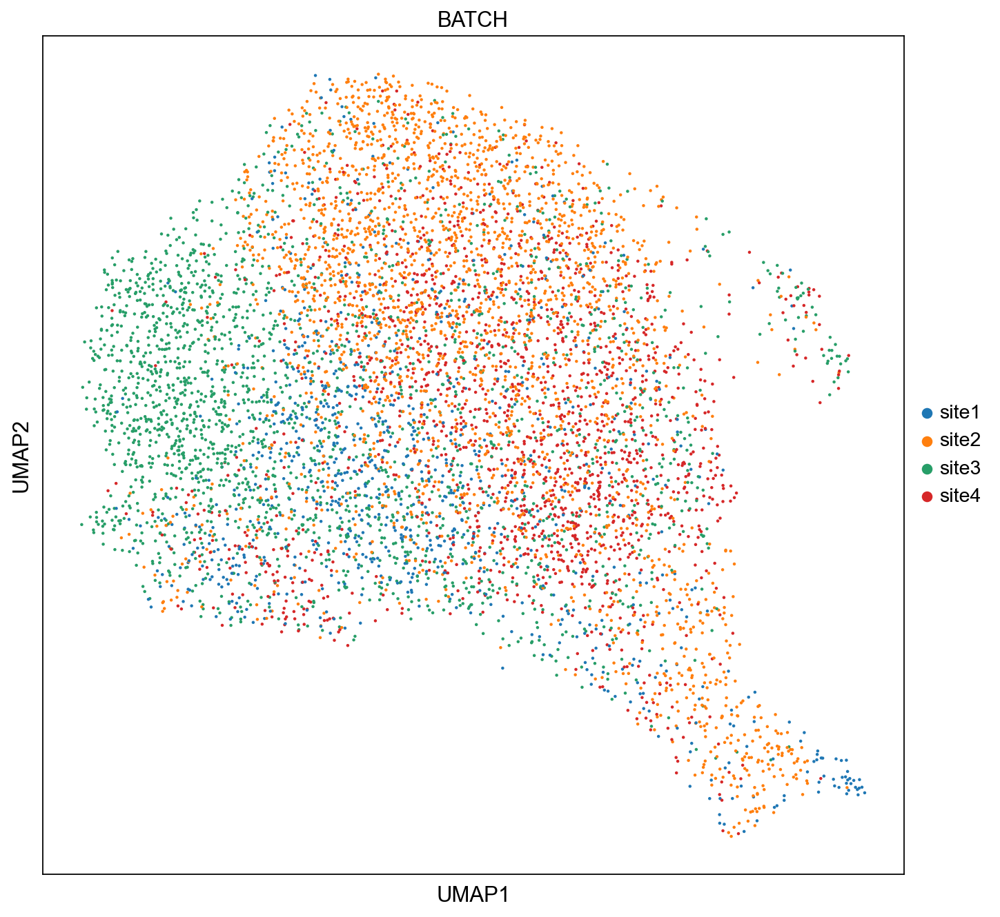

In [10]:
sc.set_figure_params(figsize=(10, 10))

sc.pl.umap(adata_nk, color = ['BATCH'], color_map = 'viridis')

## Clustering part I

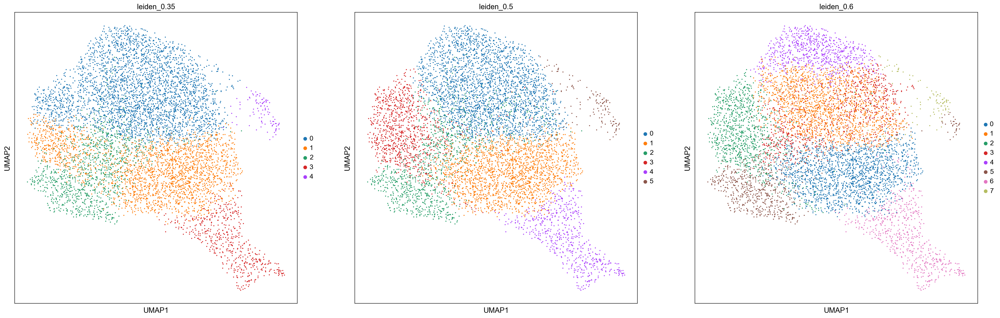

In [11]:
sc.tl.leiden(adata_nk, resolution = 0.35, key_added = "leiden_0.35")
sc.tl.leiden(adata_nk, resolution = 0.5, key_added = "leiden_0.5")
sc.tl.leiden(adata_nk, resolution = 0.6, key_added = "leiden_0.6")

sc.pl.umap(adata_nk, color=['leiden_0.35', 'leiden_0.5', 'leiden_0.6'], ncols =3)

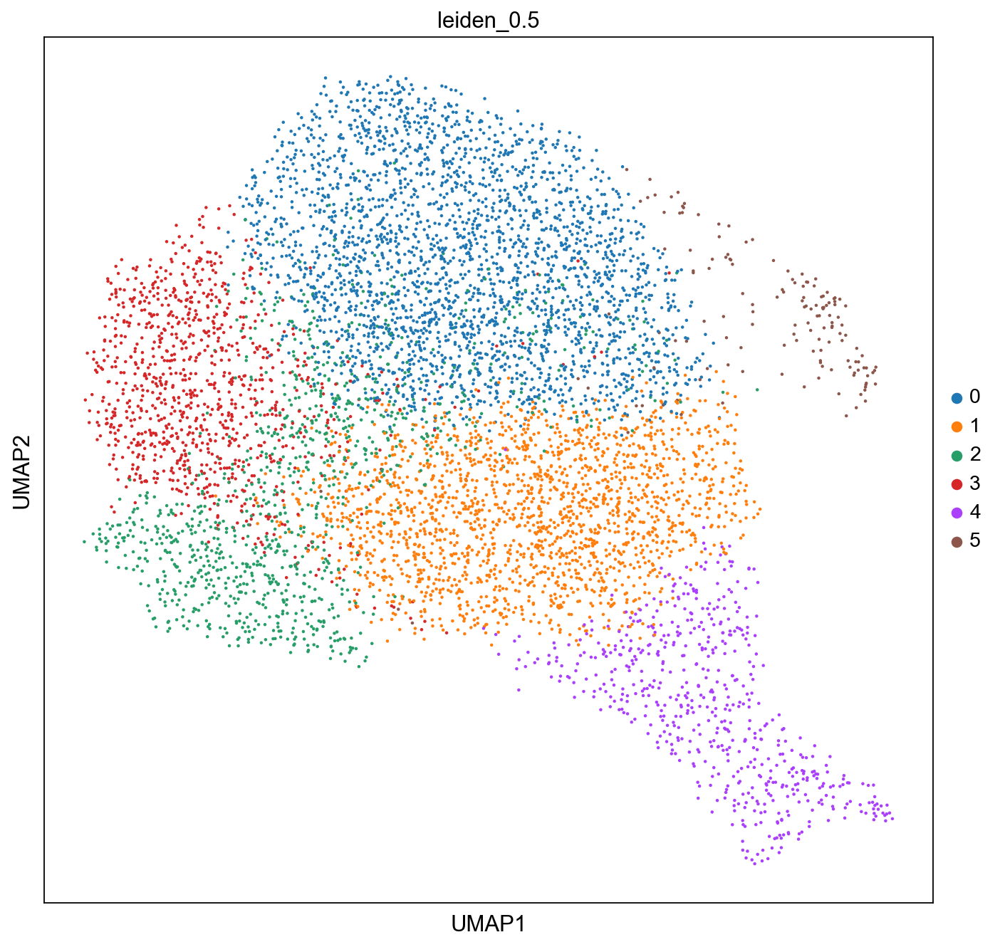

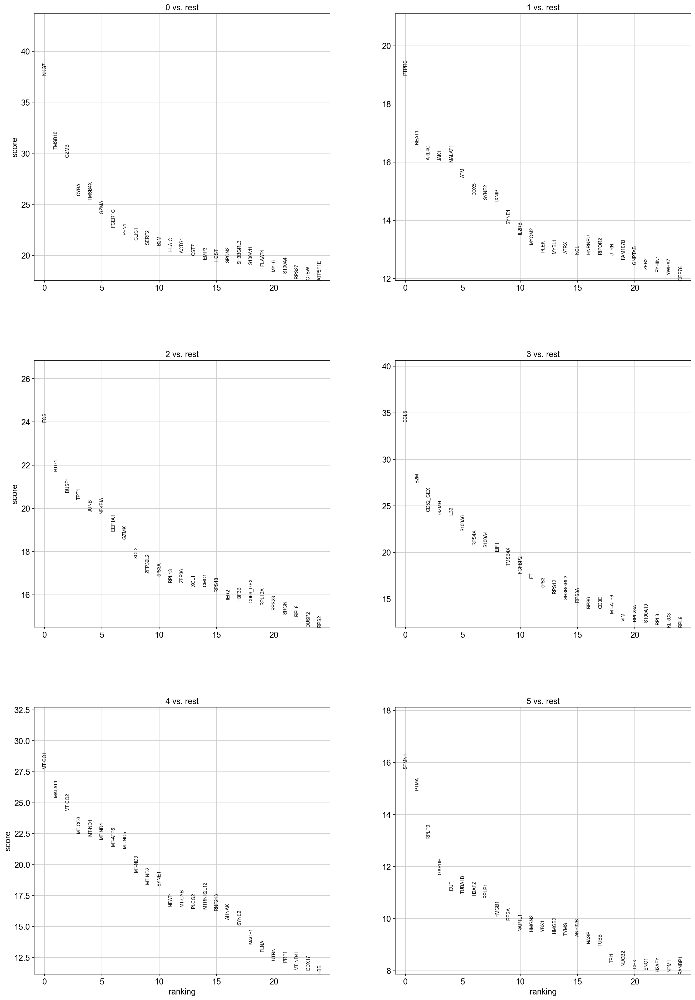

In [12]:
sc.pl.umap(adata_nk, color=['leiden_0.5'], ncols =3)

sc.tl.rank_genes_groups(adata_nk, 'leiden_0.5', method='wilcoxon')
sc.pl.rank_genes_groups(adata_nk, n_genes=25, sharey=False, ncols=2)

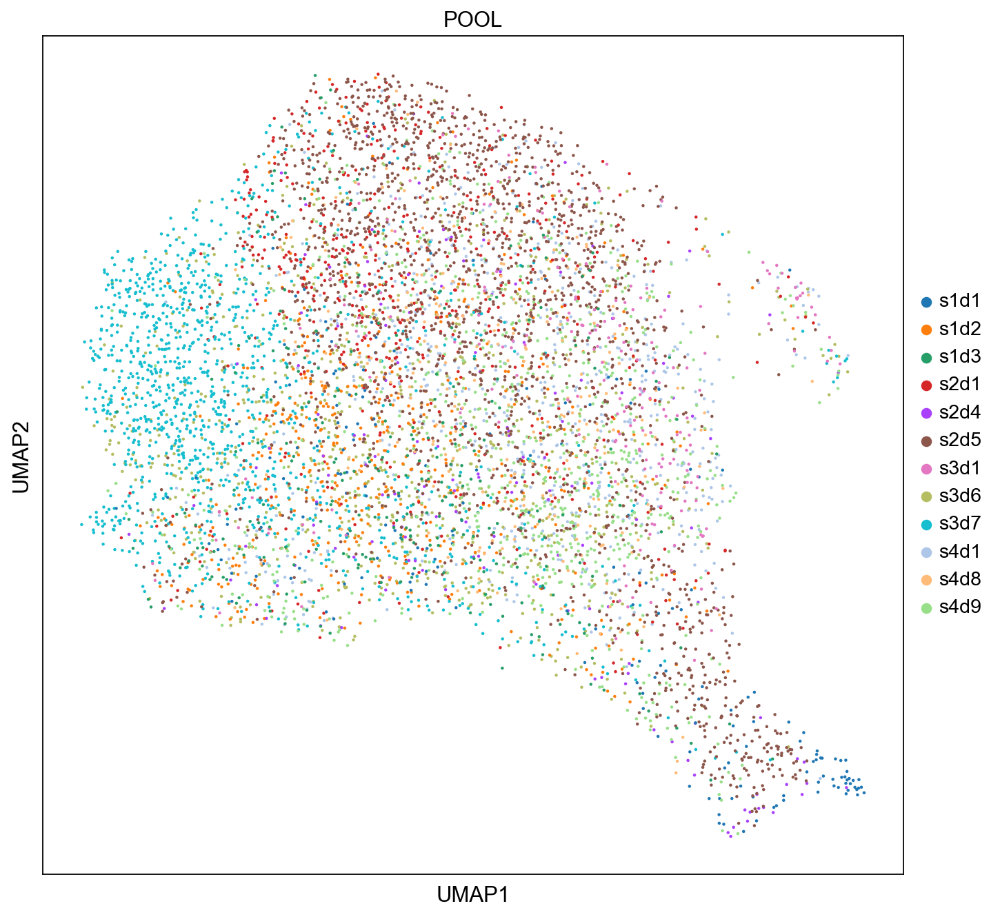

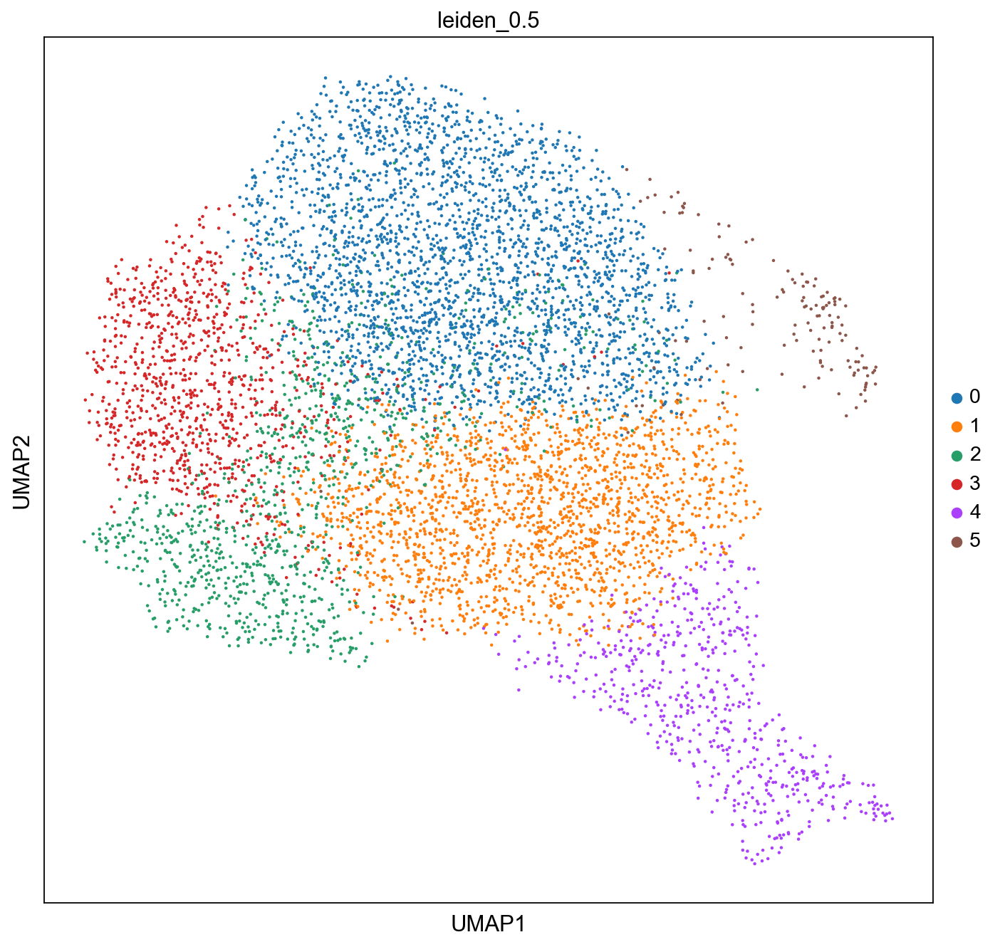

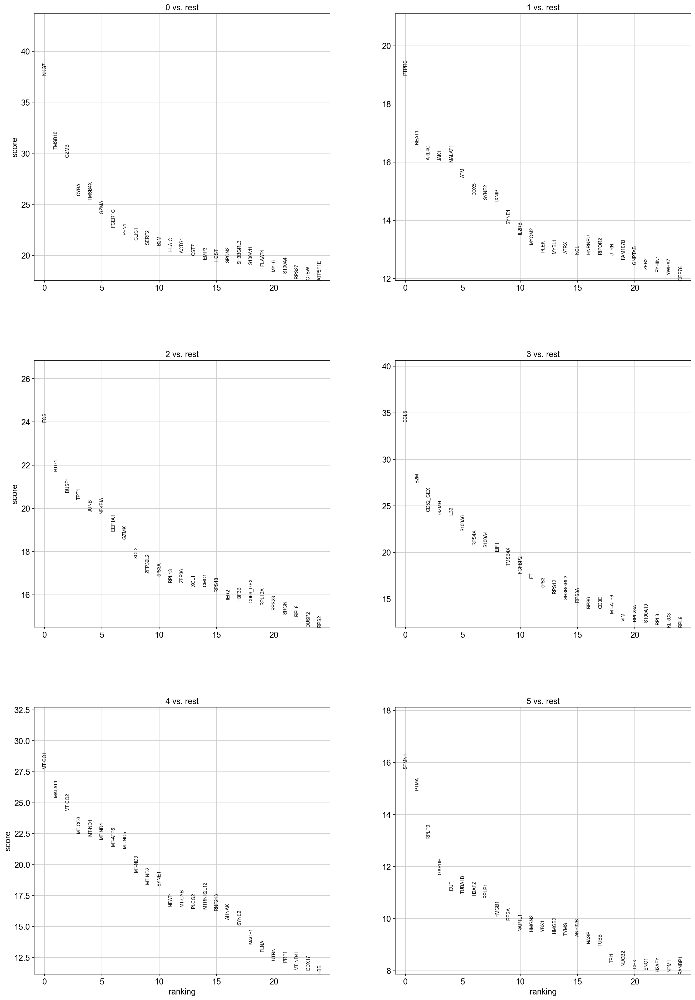

In [13]:
sc.pl.umap(adata_nk, color = ['POOL'], color_map = 'viridis')
sc.pl.umap(adata_nk, color=['leiden_0.5'], ncols =3)

sc.tl.rank_genes_groups(adata_nk, 'leiden_0.5', method='wilcoxon')
sc.pl.rank_genes_groups(adata_nk, n_genes=25, sharey=False, ncols=2)

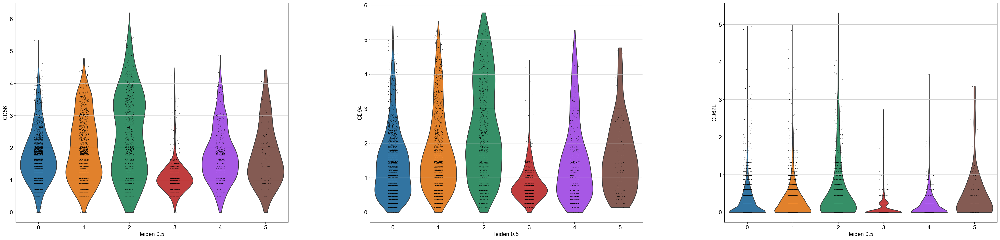

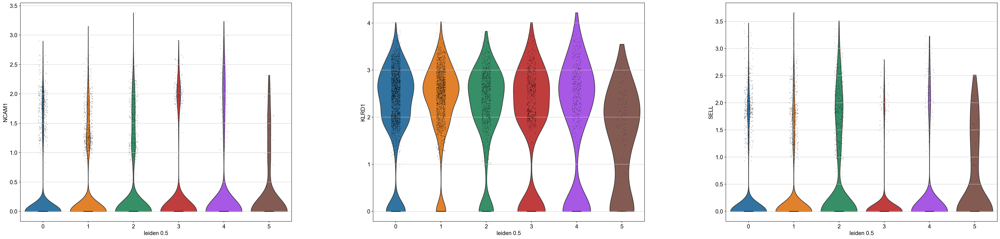

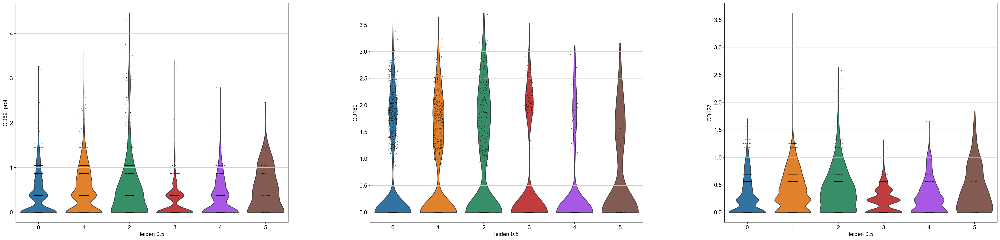

In [14]:
#Immature CD56bright proteins and corresponding RNA

sc.pl.violin(adata_nk, ['CD56', 'CD94', 'CD62L'], groupby='leiden_0.5')
sc.pl.violin(adata_nk, ['NCAM1', 'KLRD1', 'SELL'], groupby='leiden_0.5')
sc.pl.violin(adata_nk, ['CD69_prot', 'CD160', 'CD127'], groupby='leiden_0.5')
sc.set_figure_params(scanpy=True, fontsize=25, figsize = [7,5])

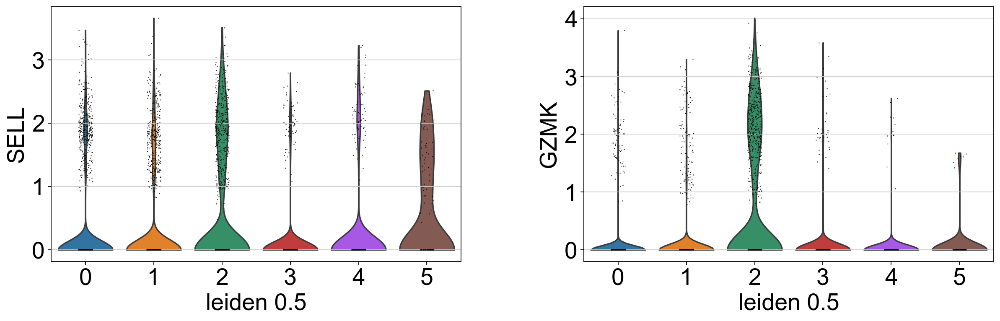

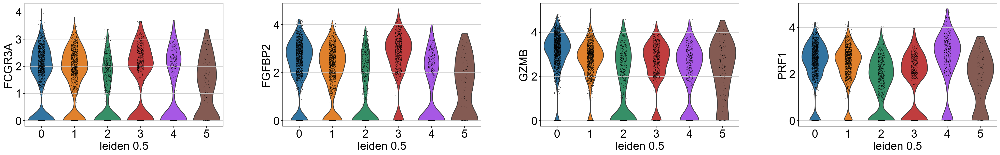

In [15]:
#CD65dim GZMK+ NK markers, transitional state between mature and immature (Melsen)

sc.pl.violin(adata_nk, ['SELL', 'GZMK'], groupby='leiden_0.5')

sc.pl.violin(adata_nk, ['FCGR3A', 'FGFBP2', 'GZMB', 'PRF1'], groupby='leiden_0.5')

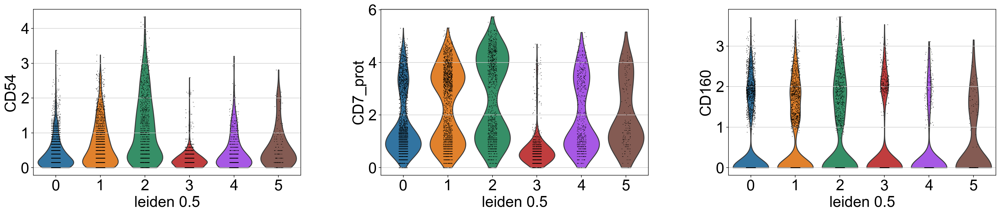

In [16]:
#tissue-resident NK, high markers, these markers identified by Catboost
sc.pl.violin(adata_nk, ['CD54', 'CD7_prot', 'CD160'], groupby='leiden_0.5')

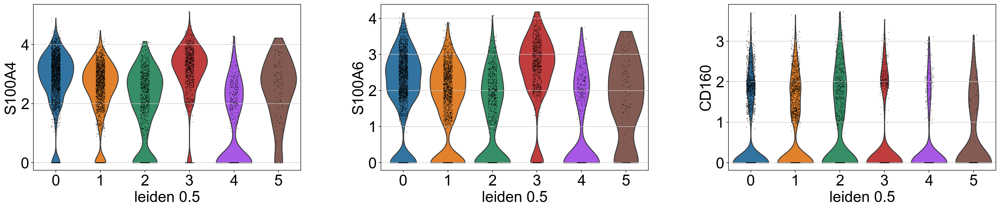

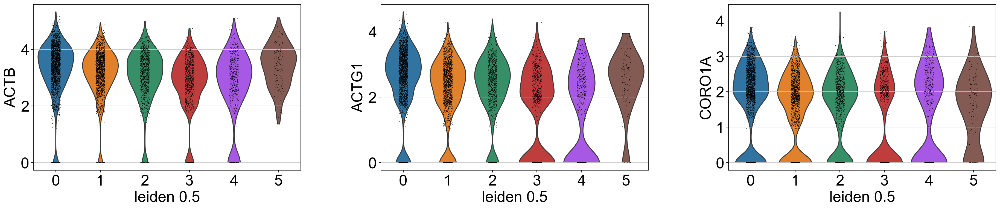

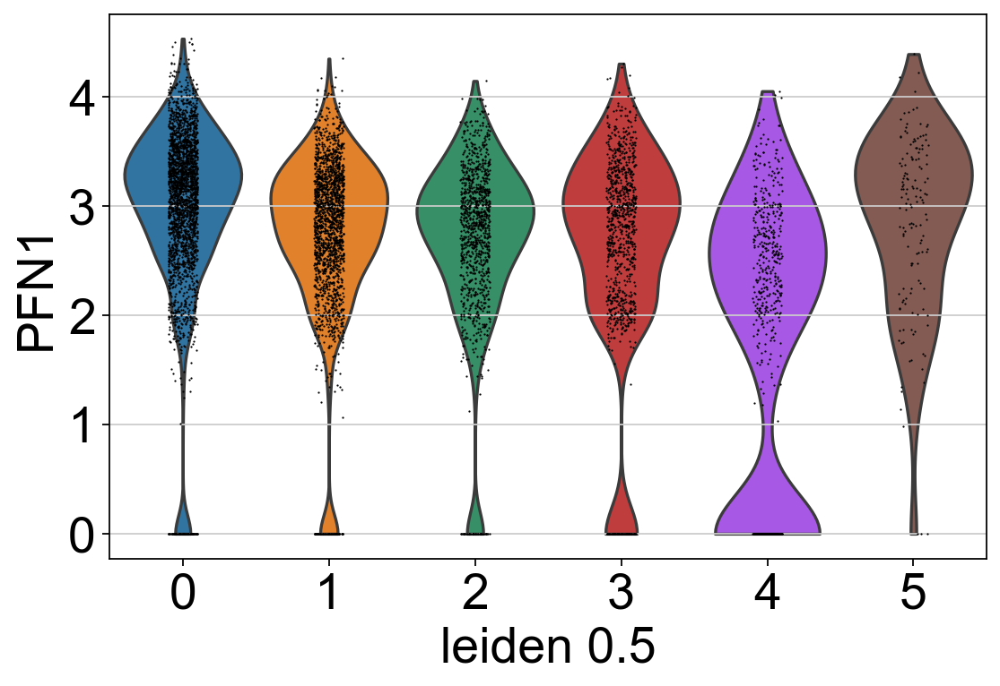

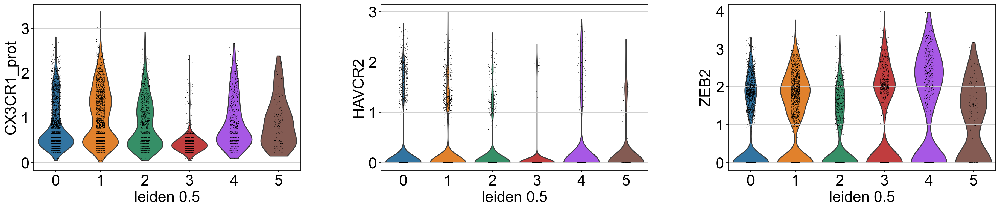

In [17]:
#Terminally differentiated (yang)

#Terminally differentiated NK
sc.pl.violin(adata_nk, ['S100A4', 'S100A6', 'CD160'], groupby='leiden_0.5')

#Cytoskeleton markers  => CD57+ high cytotoxicity 
sc.pl.violin(adata_nk, ['ACTB', 'ACTG1', 'CORO1A'], groupby='leiden_0.5') 
sc.pl.violin(adata_nk, ['PFN1'], groupby='leiden_0.5')

# CX3CR1, HAVCR2 (TIM-3), and ZEB2 

sc.pl.violin(adata_nk, ['CX3CR1_prot', 'HAVCR2', 'ZEB2'], groupby='leiden_0.5')



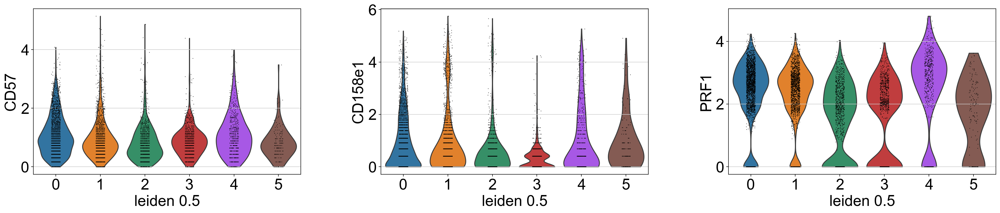

In [18]:
#Terminally differentiated NK

sc.pl.violin(adata_nk, ['CD57', 'CD158e1', 'PRF1'], groupby='leiden_0.5')

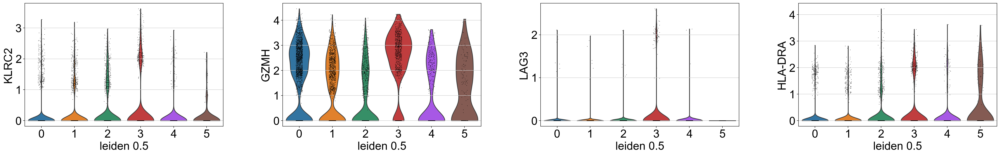

In [19]:
#Adaptive NK cells, KLRC2 = NKG2A, from Dufva,Huuhtanen et al. paper(s)

sc.pl.violin(adata_nk, ['KLRC2', 'GZMH', 'LAG3', 'HLA-DRA'] , groupby='leiden_0.5')



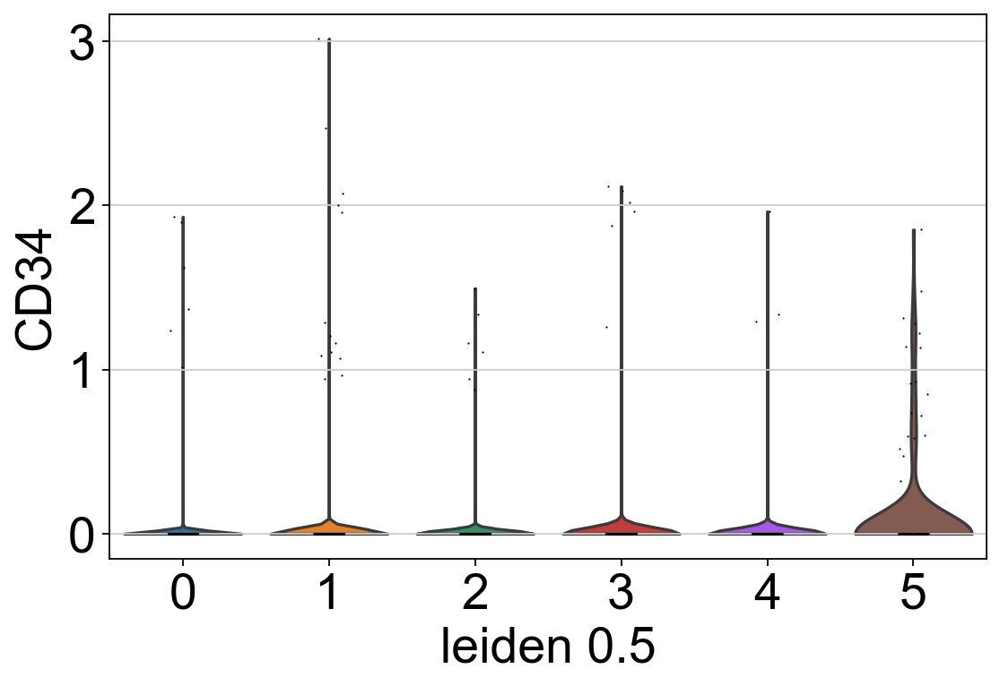

In [20]:
sc.pl.violin(adata_nk, ['CD34'], groupby='leiden_0.5')

## Cell cycle scoring

In [21]:
#list of genes

cell_cycle_genes = [x.strip() for x in open('/Users/tiinatuononen/Desktop/Thesis/Project/data/cell_cycle_vignette_files/regev_lab_cell_cycle_genes.txt')]

#defining two lists, s-phase genes and g2m genes

s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata_nk.var_names]

#calculating scores

sc.tl.score_genes_cell_cycle(adata_nk, s_genes=s_genes, g2m_genes=g2m_genes)

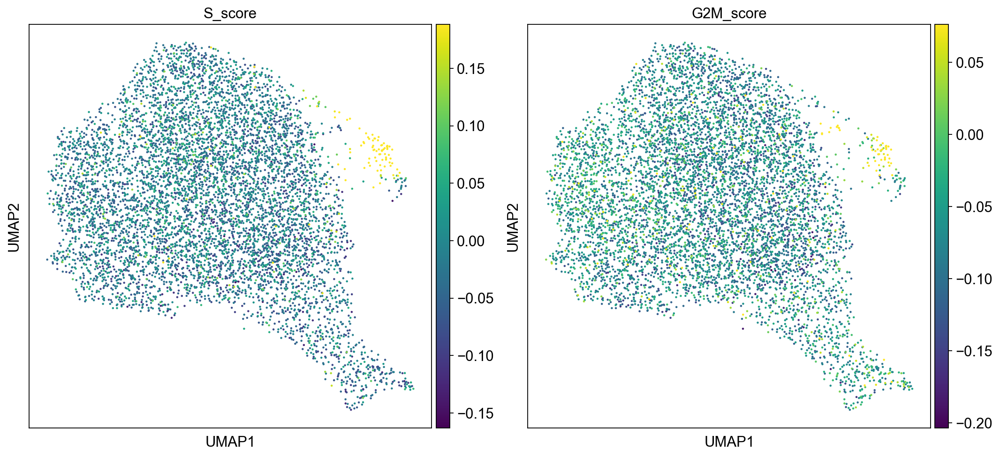

In [22]:
sc.set_figure_params(figsize=(7, 7))
sc.pl.umap(adata_nk, color = ['S_score', 'G2M_score'], vmax="p99", color_map = 'viridis', ncols = 3)



In [23]:
adata_nk

AnnData object with n_obs × n_vars = 7388 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS', 'CD86', 'CD274', 'CD270', 'CD155', 'CD112', 'CD47', 'CD48', 'CD40', 'CD154', 'CD52', 'CD3', 'CD8', 'CD56', 'CD19', 'CD33', 'CD11c', 'HLA-A-B-C', 'CD45RA', 'CD123', 'CD7_prot', 'CD105', 'CD49f', 'CD194', 'CD4', 'CD44_prot', 'CD14', 'CD16', 'CD25',

In [24]:
adata_nk.obs['POOL'].unique().tolist()

['s4d1',
 's3d6',
 's1d2',
 's2d1',
 's3d7',
 's2d4',
 's1d1',
 's4d9',
 's4d8',
 's2d5',
 's3d1',
 's1d3']

## Clustering part II 

- cluster 3 contains mostly cells from one sample => cluster removed

In [25]:
adata_nk1 = adata_nk[(adata_nk.obs['leiden_0.5'] == "1") | (adata_nk.obs['leiden_0.5'] == "2")
                    | (adata_nk.obs['leiden_0.5'] == "4") | (adata_nk.obs['leiden_0.5'] == "5")
                     | (adata_nk.obs['leiden_0.5'] == "0")]
                    


In [26]:
adata_nk1

View of AnnData object with n_obs × n_vars = 6404 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS', 'CD86', 'CD274', 'CD270', 'CD155', 'CD112', 'CD47', 'CD48', 'CD40', 'CD154', 'CD52', 'CD3', 'CD8', 'CD56', 'CD19', 'CD33', 'CD11c', 'HLA-A-B-C', 'CD45RA', 'CD123', 'CD7_prot', 'CD105', 'CD49f', 'CD194', 'CD4', 'CD44_prot', 'CD14', 'CD16',

In [27]:
#Computing a neighborhood of observations using latent space

sc.pp.neighbors(adata_nk1, use_rep="X_totalVI")   

sc.tl.umap(adata_nk1)

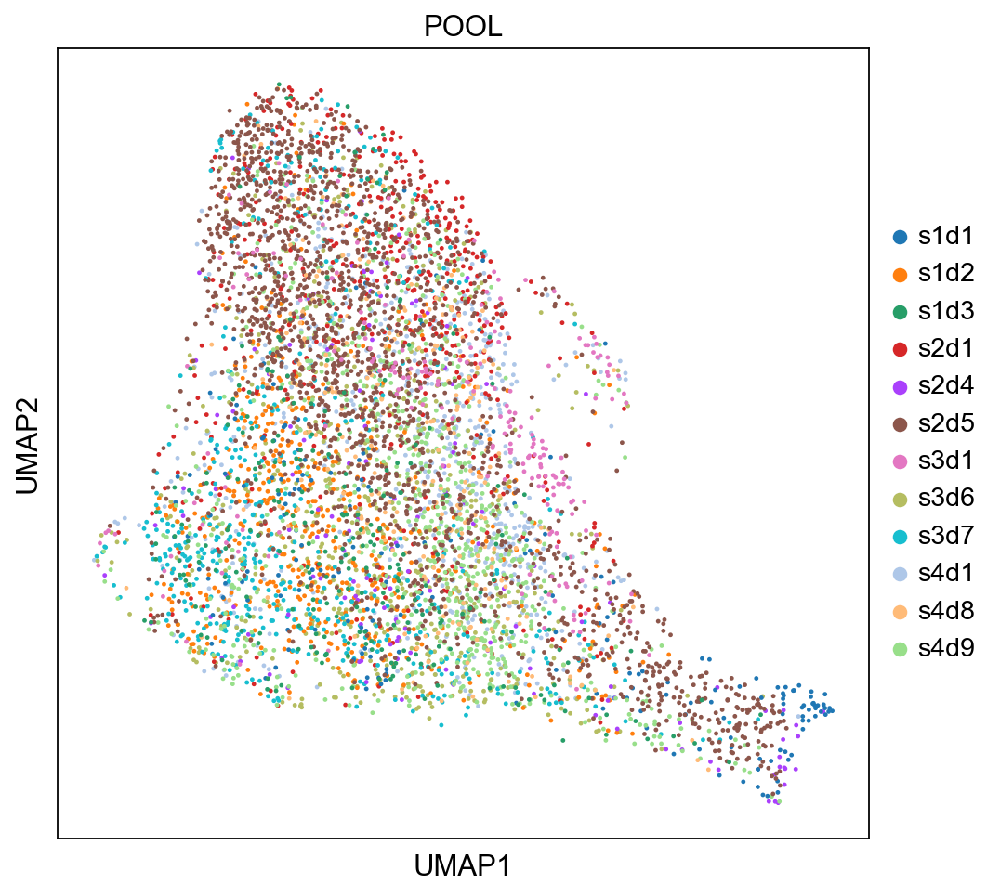

In [28]:
sc.pl.umap(adata_nk1, color = ['POOL'], color_map = 'viridis')

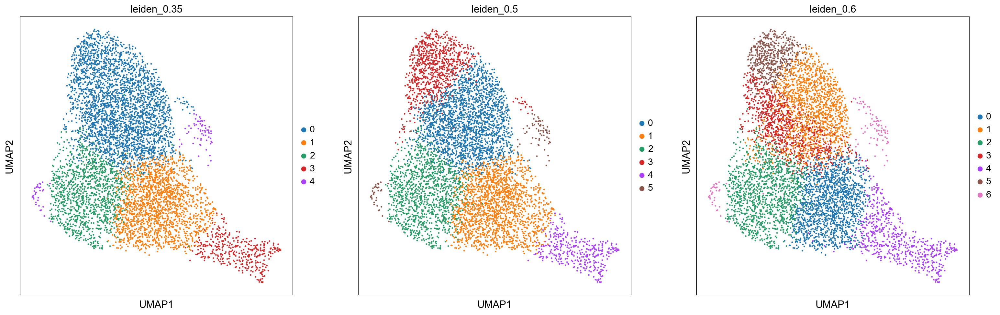

In [29]:
sc.tl.leiden(adata_nk1, resolution = 0.35, key_added = "leiden_0.35")
sc.tl.leiden(adata_nk1, resolution = 0.5, key_added = "leiden_0.5")
sc.tl.leiden(adata_nk1, resolution = 0.6, key_added = "leiden_0.6")

sc.pl.umap(adata_nk1, color=['leiden_0.35', 'leiden_0.5', 'leiden_0.6'], ncols =3)

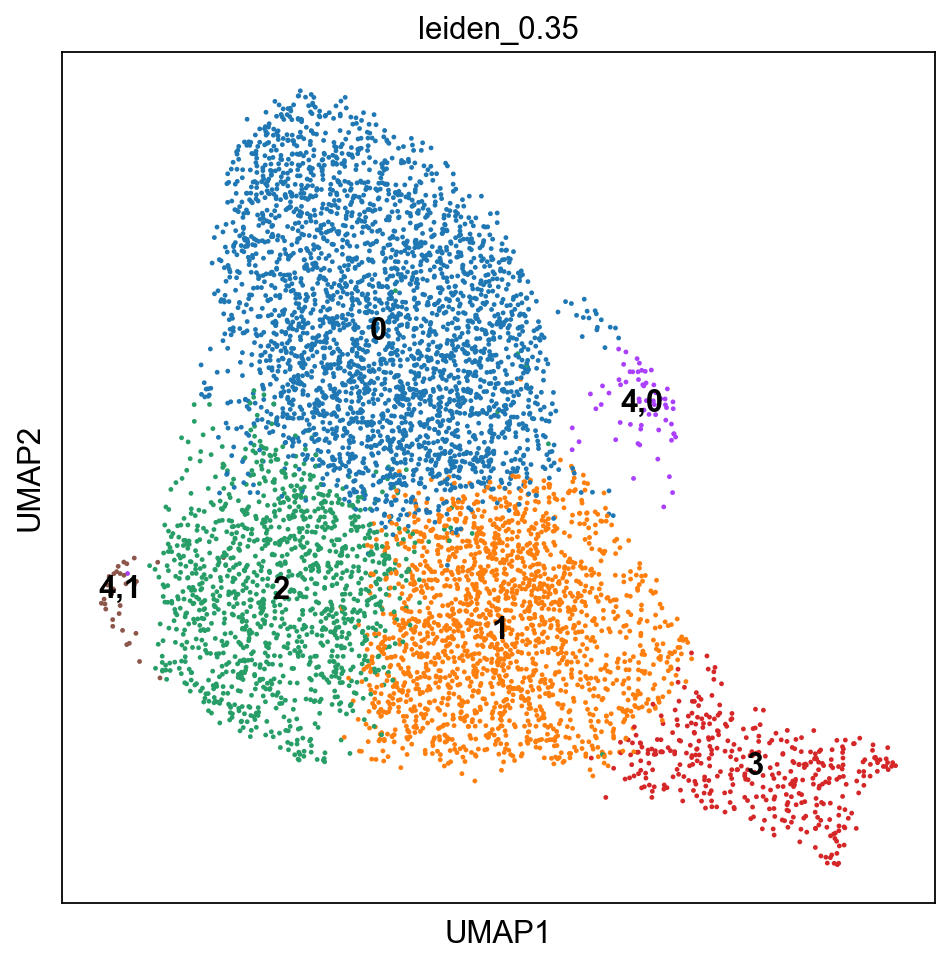

0      2913
1      1796
2      1214
3       384
4,0      64
4,1      33
Name: leiden_0.35, dtype: int64

In [30]:
orig_key = 'leiden_0.35' 
new_key = 'leiden_0.35'
new_rg_key = 'rg_res0.35_sub'
sub_key = '4'

res = 0.2
sc.tl.leiden(adata_nk1, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_nk1, color=new_key, legend_loc = 'on data')
adata_nk1.obs[new_key].value_counts()

In [31]:
#Removing MALAT1 and mito + ribo genes from adata_gex

#MALAT1 is more or less technical finding => remove

#malat1 = adata_gex.var_names.str.startswith('MALAT1')

#genes to be removed
mito_genes = adata_nk1.var_names.str.startswith('MT-')
ribo_genes = adata_nk1.var_names.str.startswith('RPL')
ribo_genes1 = adata_nk1.var_names.str.startswith('RPS')

remove = np.add(mito_genes, ribo_genes)
remove = np.add(remove, ribo_genes1)

#other genes kept
keep = np.invert(remove)

adata_nk1 = adata_nk1[:,keep]

#print(adata_gex.n_obs, adata_gex.n_vars)

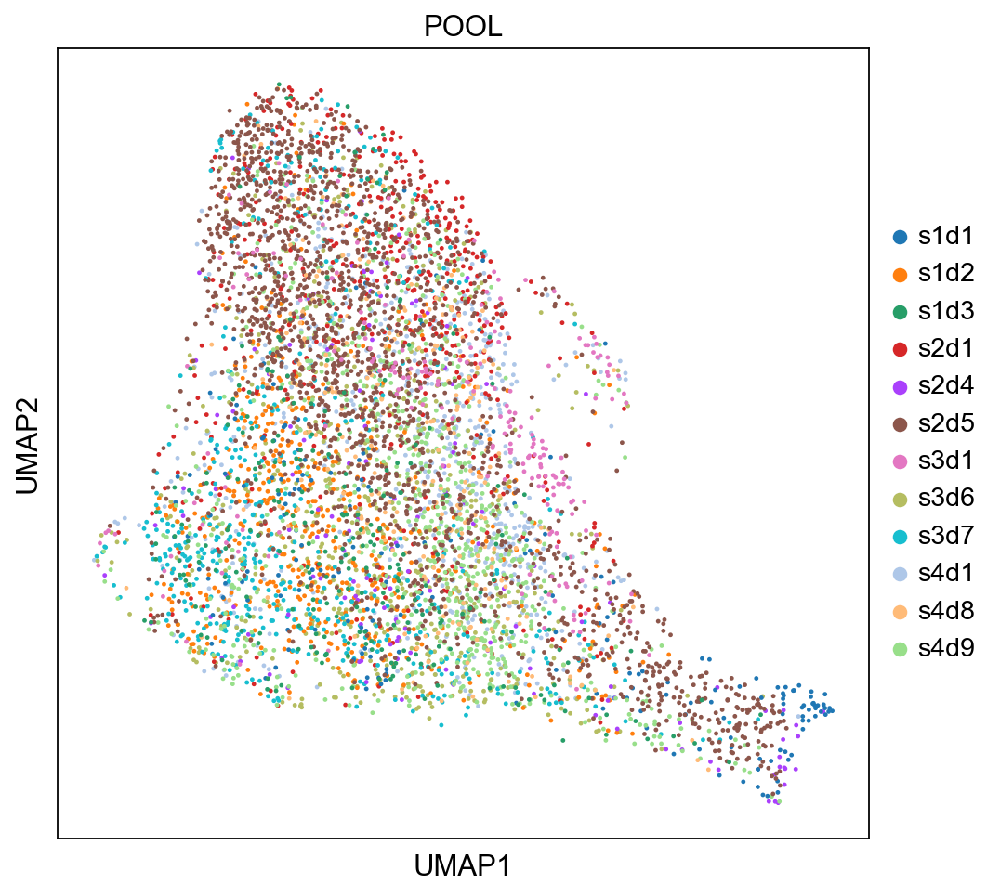

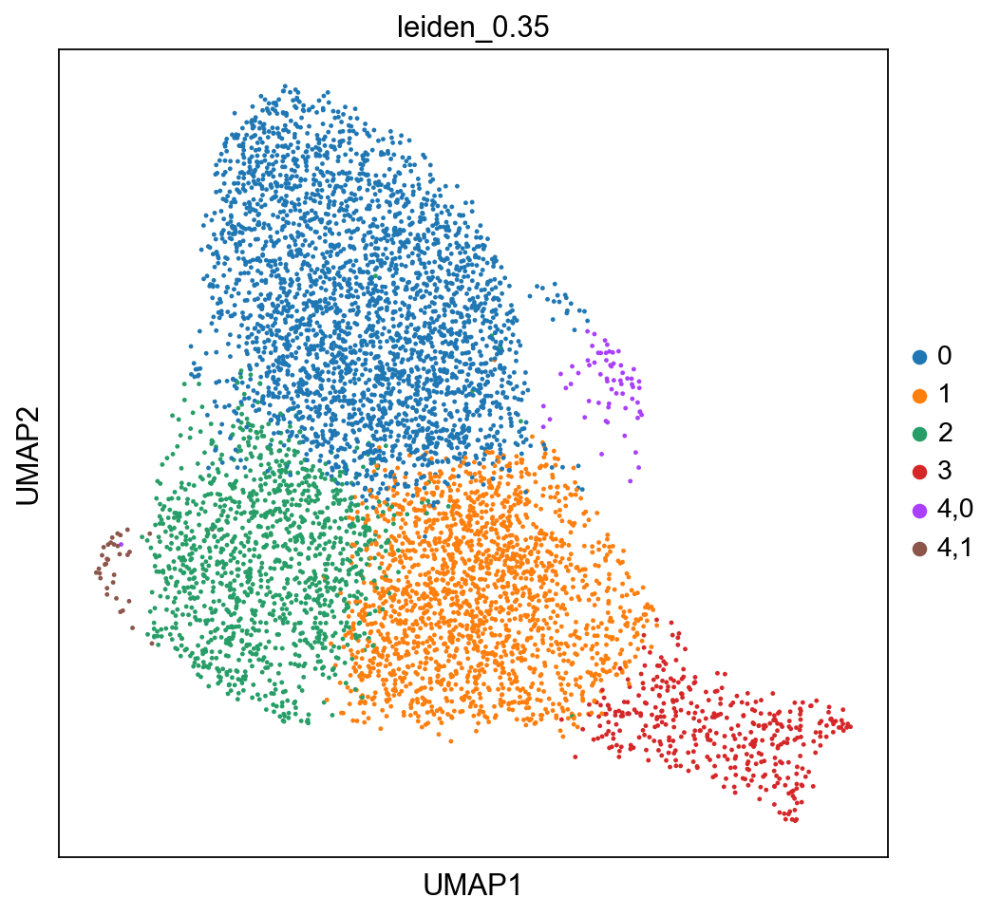

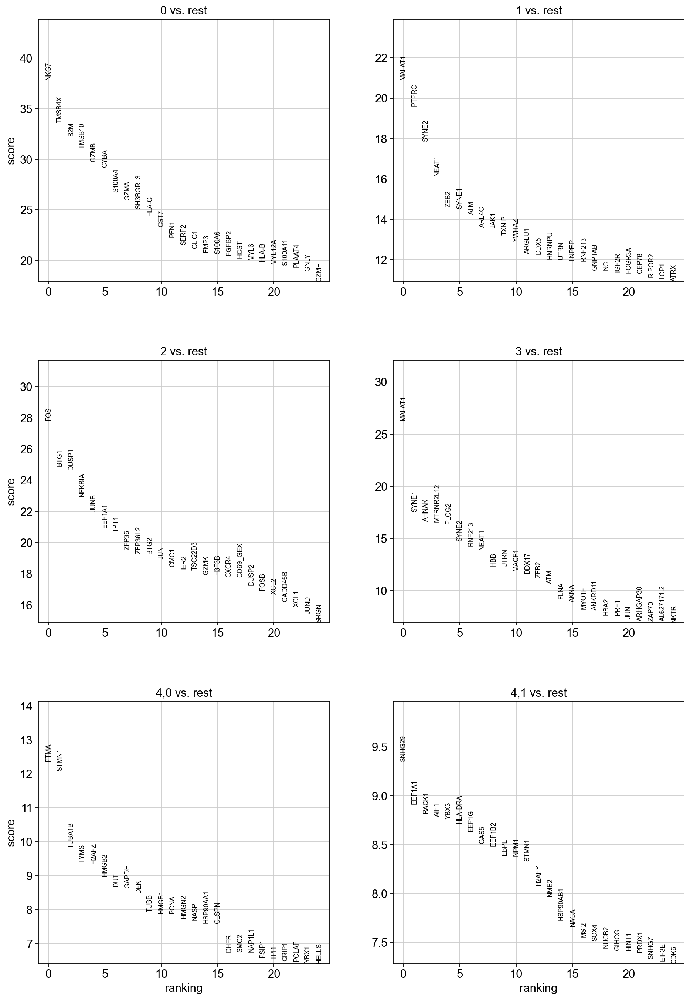

In [32]:
sc.pl.umap(adata_nk1, color = ['POOL'], color_map = 'viridis')
sc.pl.umap(adata_nk1, color=['leiden_0.35'], ncols =3)

sc.tl.rank_genes_groups(adata_nk1, 'leiden_0.35', method='wilcoxon')
sc.pl.rank_genes_groups(adata_nk1, n_genes=25, sharey=False, ncols=2)

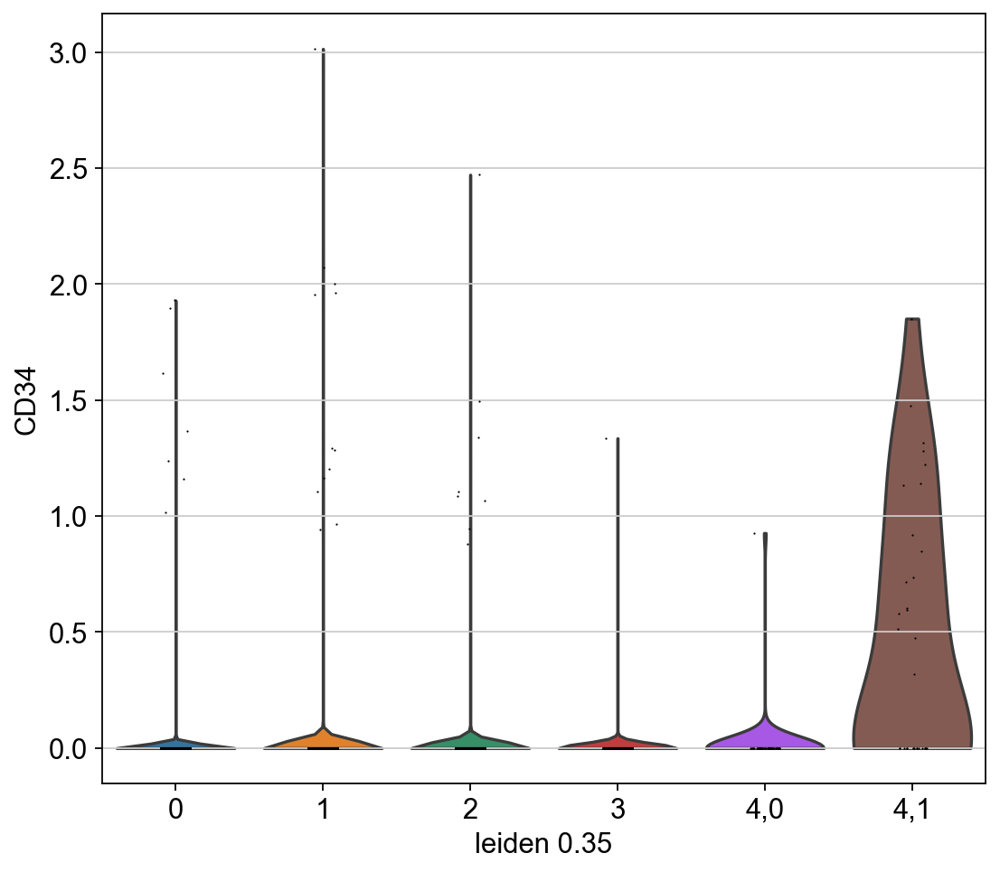

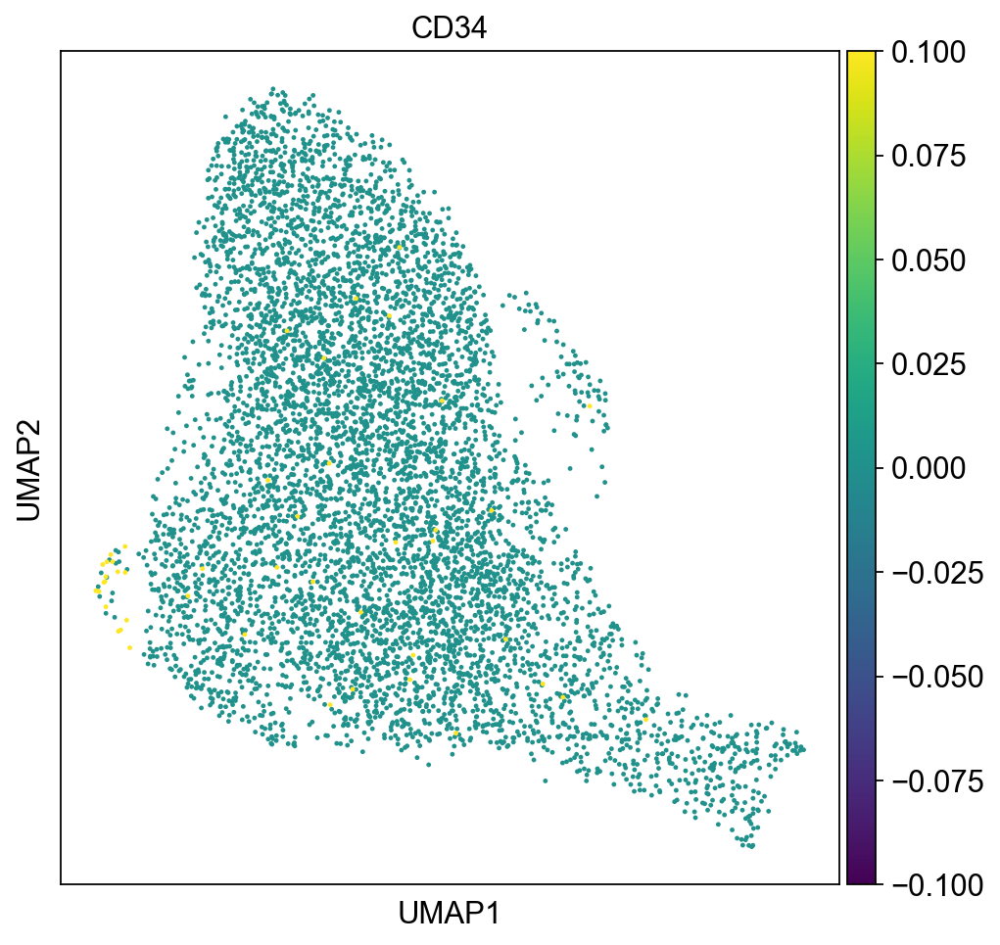

In [33]:
sc.pl.violin(adata_nk1, ['CD34'], groupby='leiden_0.35')

sc.pl.umap(adata_nk1, color = ['CD34'], vmax="p99", color_map = 'viridis', ncols = 3)

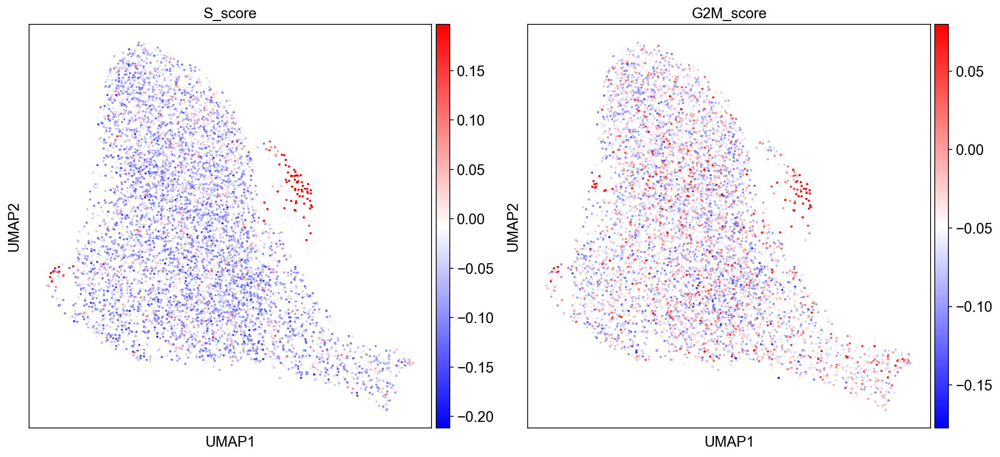

In [34]:
#defining two lists, s-phase genes and g2m genes

s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata_nk1.var_names]

#calculating scores

sc.tl.score_genes_cell_cycle(adata_nk1, s_genes=s_genes, g2m_genes=g2m_genes)

sc.set_figure_params(figsize=(7, 7))
sc.pl.umap(adata_nk1, color = ['S_score', 'G2M_score'], vmax="p99", color_map = 'bwr', ncols = 3)

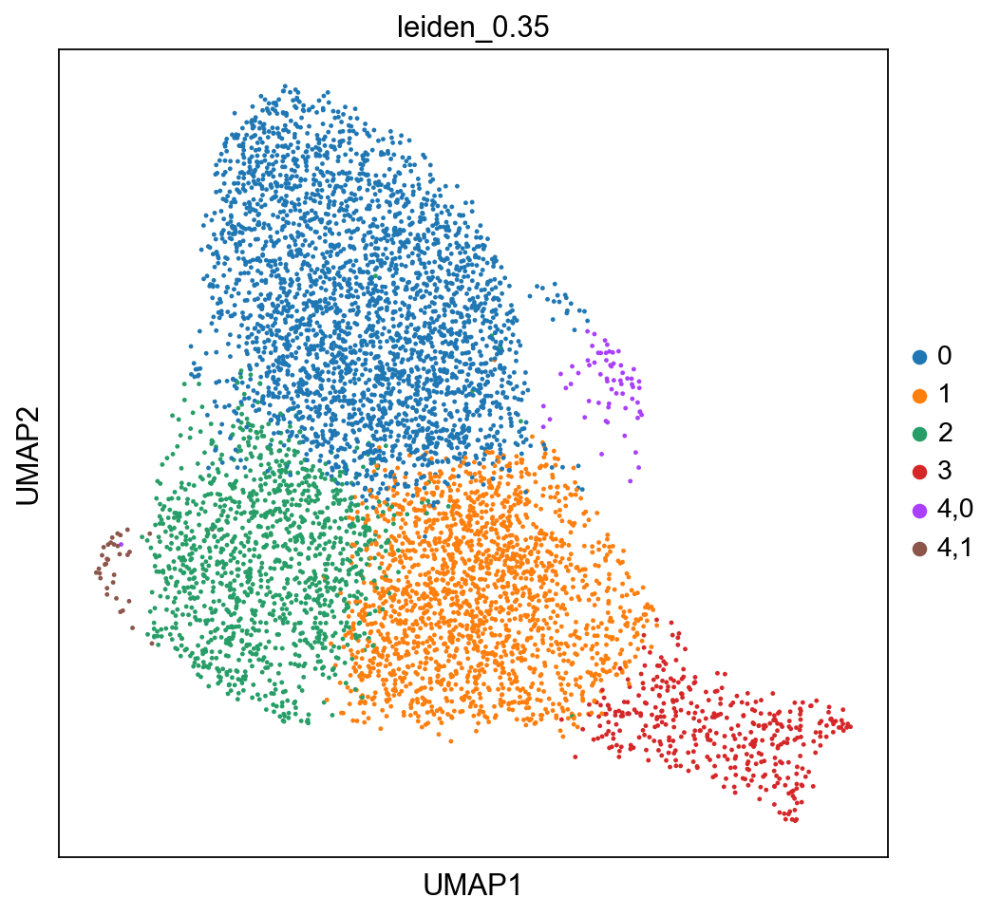

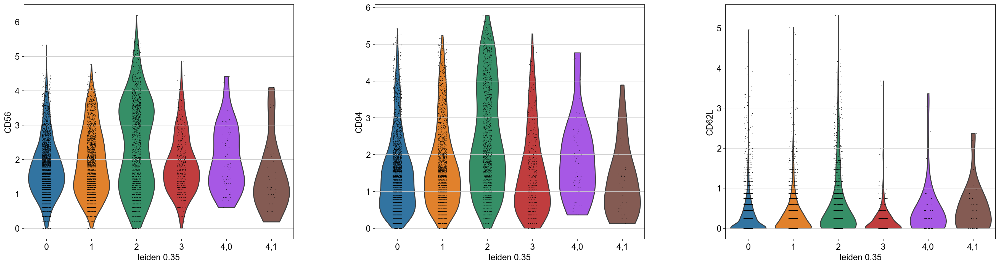

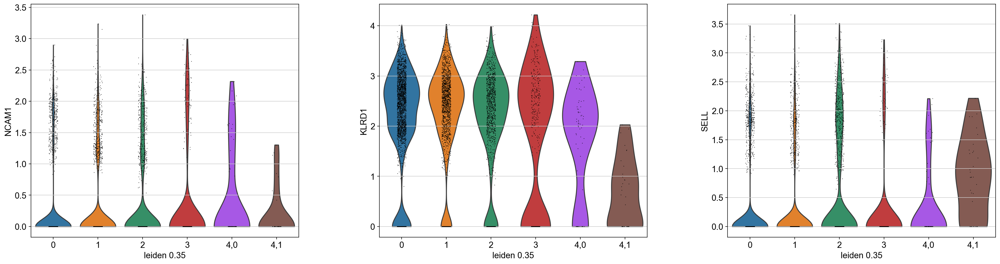

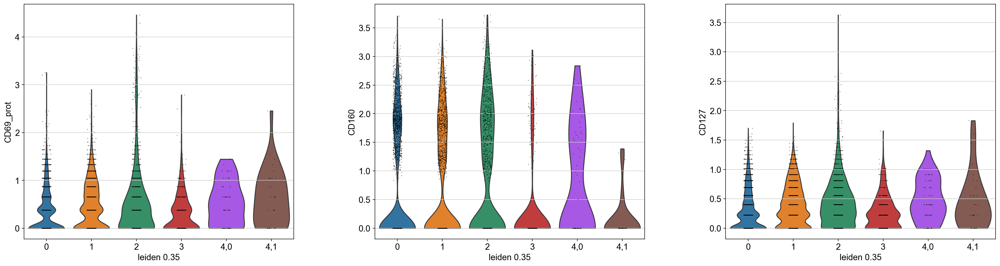

In [35]:
#Immature CD56bright proteins and corresponding RNA

sc.pl.umap(adata_nk1, color=['leiden_0.35'], ncols =3)

sc.pl.violin(adata_nk1, ['CD56', 'CD94', 'CD62L'], groupby='leiden_0.35')
sc.pl.violin(adata_nk1, ['NCAM1', 'KLRD1', 'SELL'], groupby='leiden_0.35')
sc.pl.violin(adata_nk1, ['CD69_prot', 'CD160', 'CD127'], groupby='leiden_0.35')
sc.set_figure_params(scanpy=True, fontsize=25, figsize = [7,5])

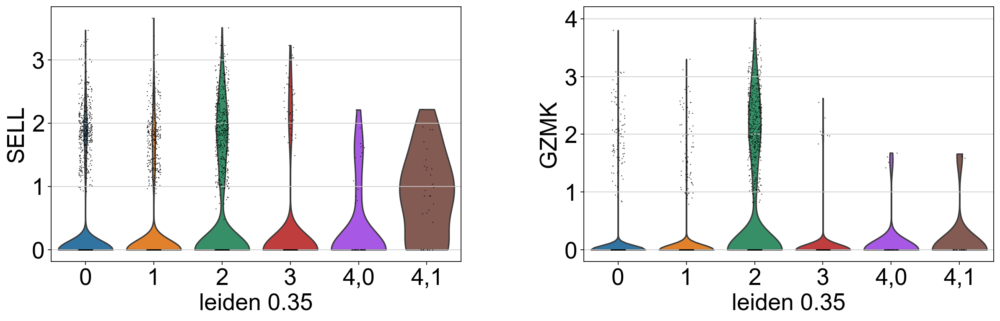

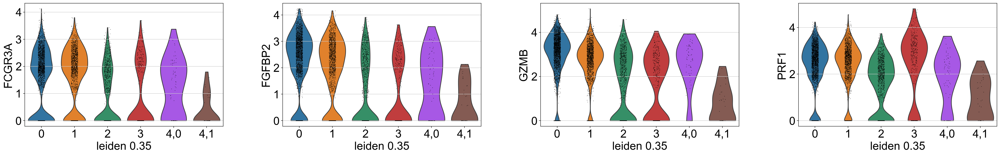

In [36]:
#CD65dim GZMK+ NK markers, transitional state between mature and immature (Melsen)

sc.pl.violin(adata_nk1, ['SELL', 'GZMK'], groupby='leiden_0.35')

sc.pl.violin(adata_nk1, ['FCGR3A', 'FGFBP2', 'GZMB', 'PRF1'], groupby='leiden_0.35')

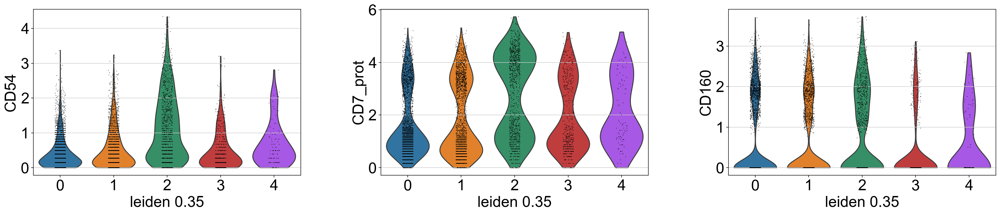

In [37]:
#tissue-resident NK, high markers, these markers identified by Catboost
sc.pl.violin(adata_nk, ['CD54', 'CD7_prot', 'CD160'], groupby='leiden_0.35')

- cluster 2 further divided, might include tissue-resident NK cells? 

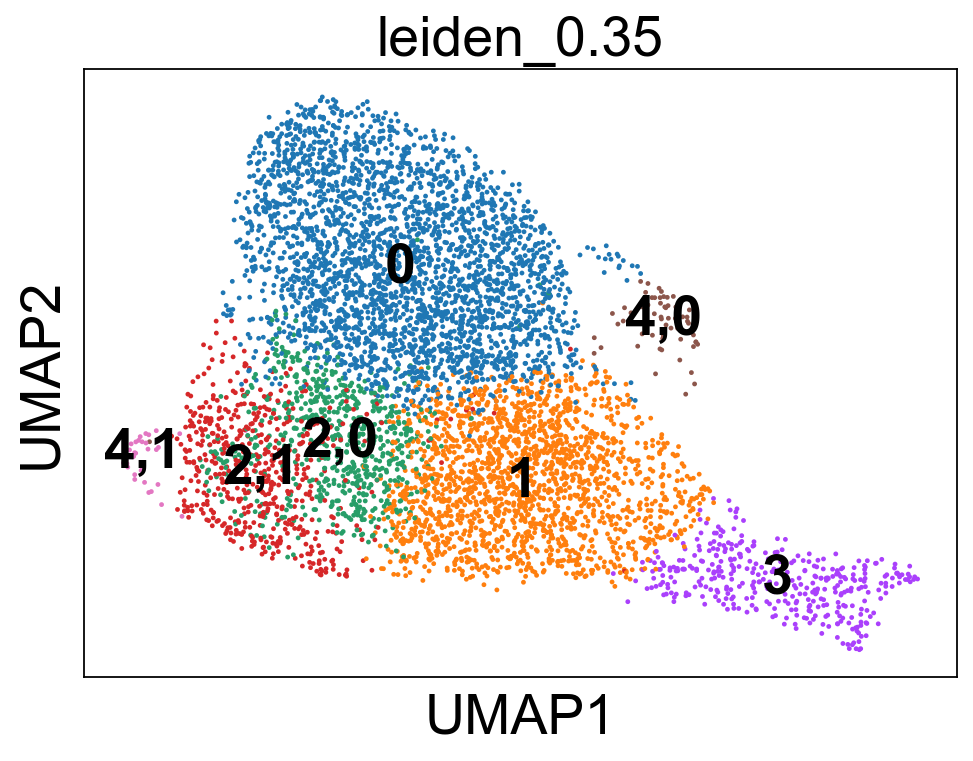

0      2913
1      1796
2,0     671
2,1     543
3       384
4,0      64
4,1      33
Name: leiden_0.35, dtype: int64

In [38]:
orig_key = 'leiden_0.35' 
new_key = 'leiden_0.35'
new_rg_key = 'rg_res0.35_sub'
sub_key = '2'

res = 0.2
sc.tl.leiden(adata_nk1, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_nk1, color=new_key, legend_loc = 'on data')
adata_nk1.obs[new_key].value_counts()

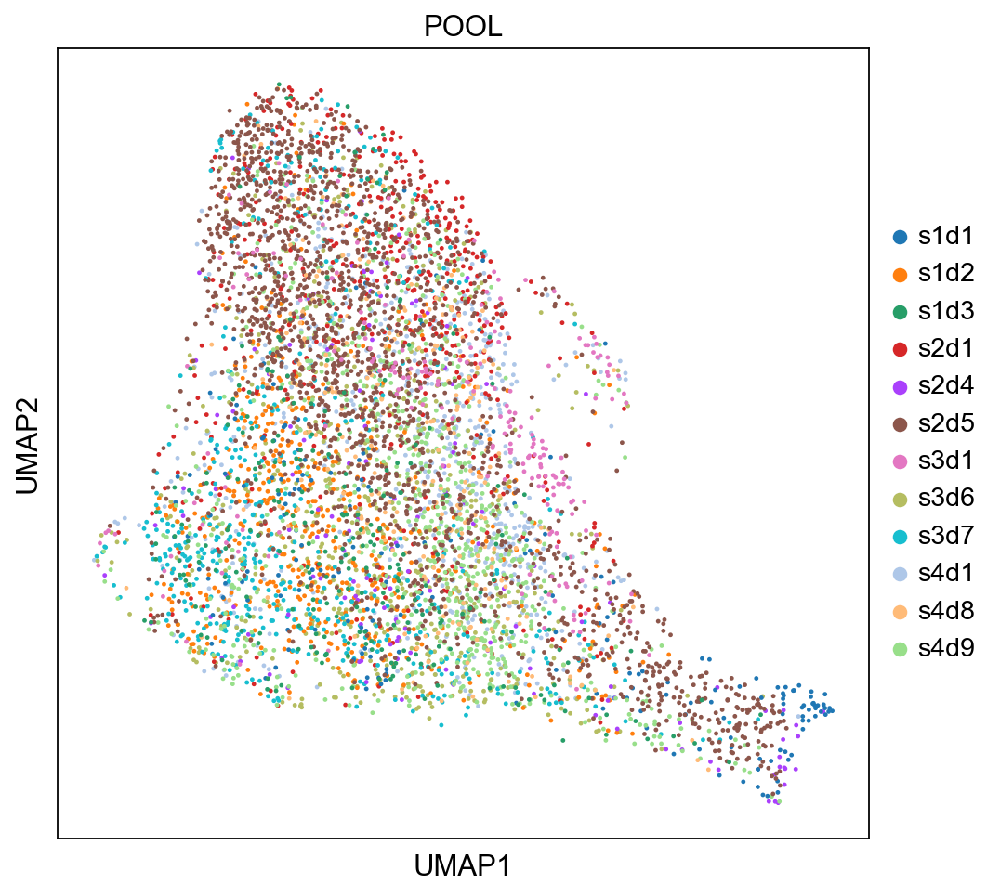

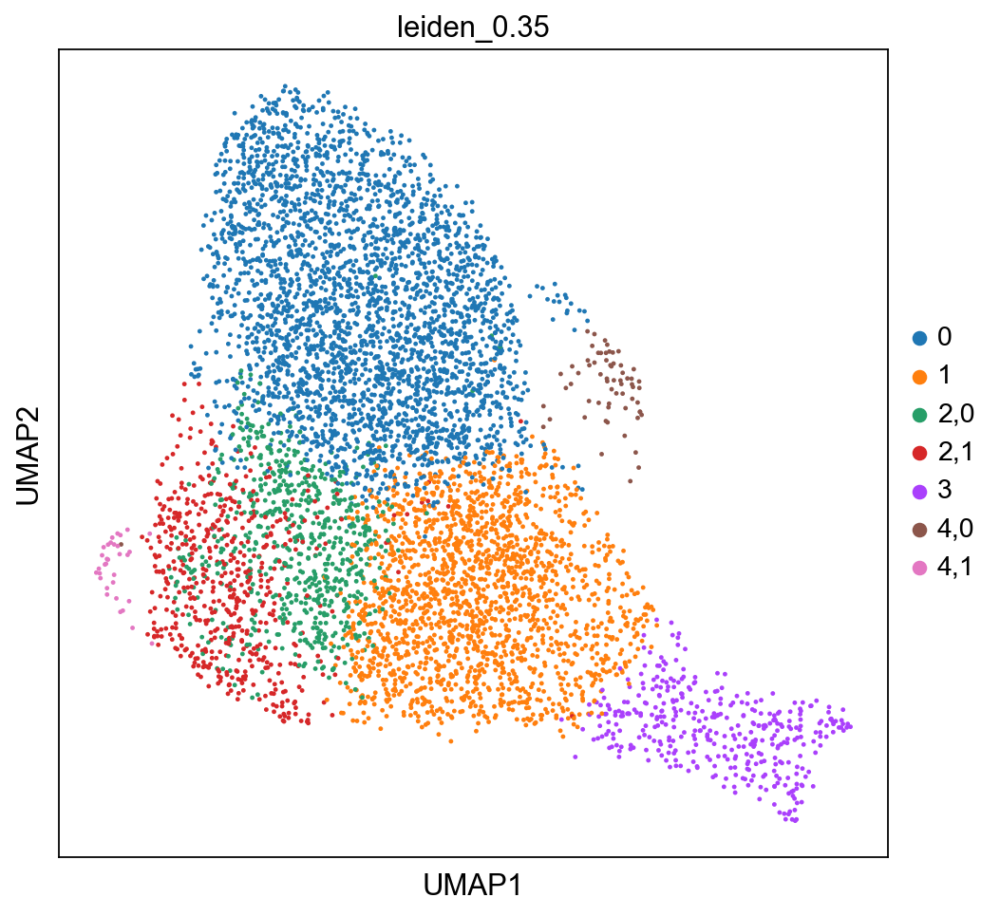

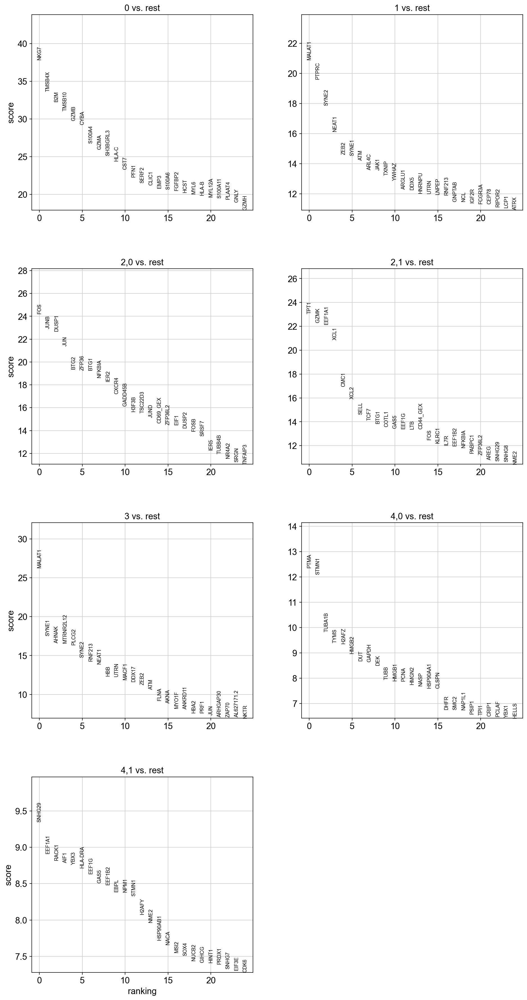

In [39]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(adata_nk1, color = ['POOL'], color_map = 'viridis')
sc.pl.umap(adata_nk1, color=['leiden_0.35'], ncols =3)

sc.tl.rank_genes_groups(adata_nk1, 'leiden_0.35', method='wilcoxon')
sc.pl.rank_genes_groups(adata_nk1, n_genes=25, sharey=False, ncols=2)

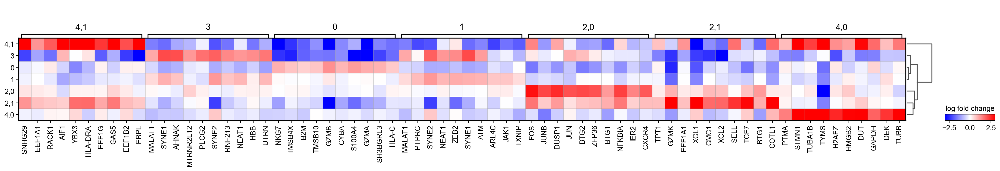

In [40]:
sc.pl.rank_genes_groups_matrixplot(adata_nk1, n_genes=10, use_raw=False, values_to_plot="logfoldchanges", colorbar_title='log fold change', vmin=-3, vmax=3, cmap='bwr')

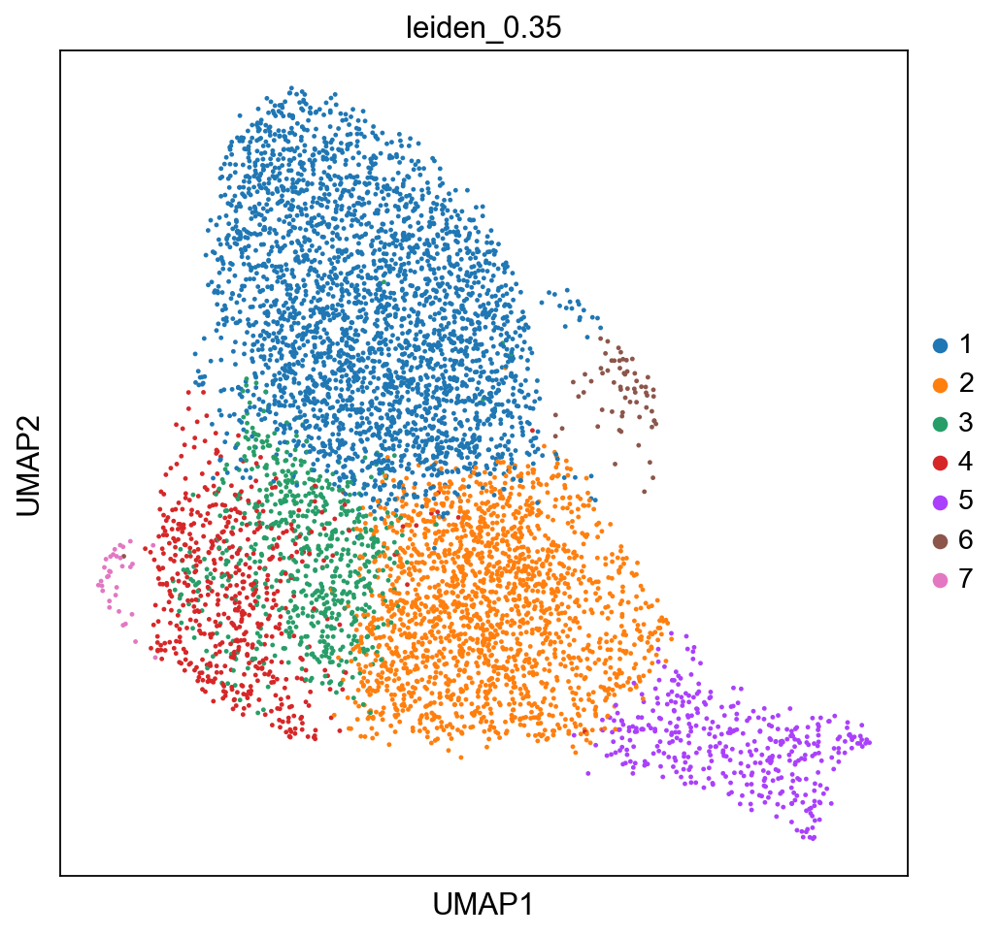

In [41]:
sc.set_figure_params(figsize=(7, 7))
new_cluster_names = [
    '1', '2',
    '3', '4',
    '5', '6', '7']

adata_nk1.rename_categories('leiden_0.35', new_cluster_names)

#Latent

sc.pl.umap(adata_nk1, color=['leiden_0.35'])

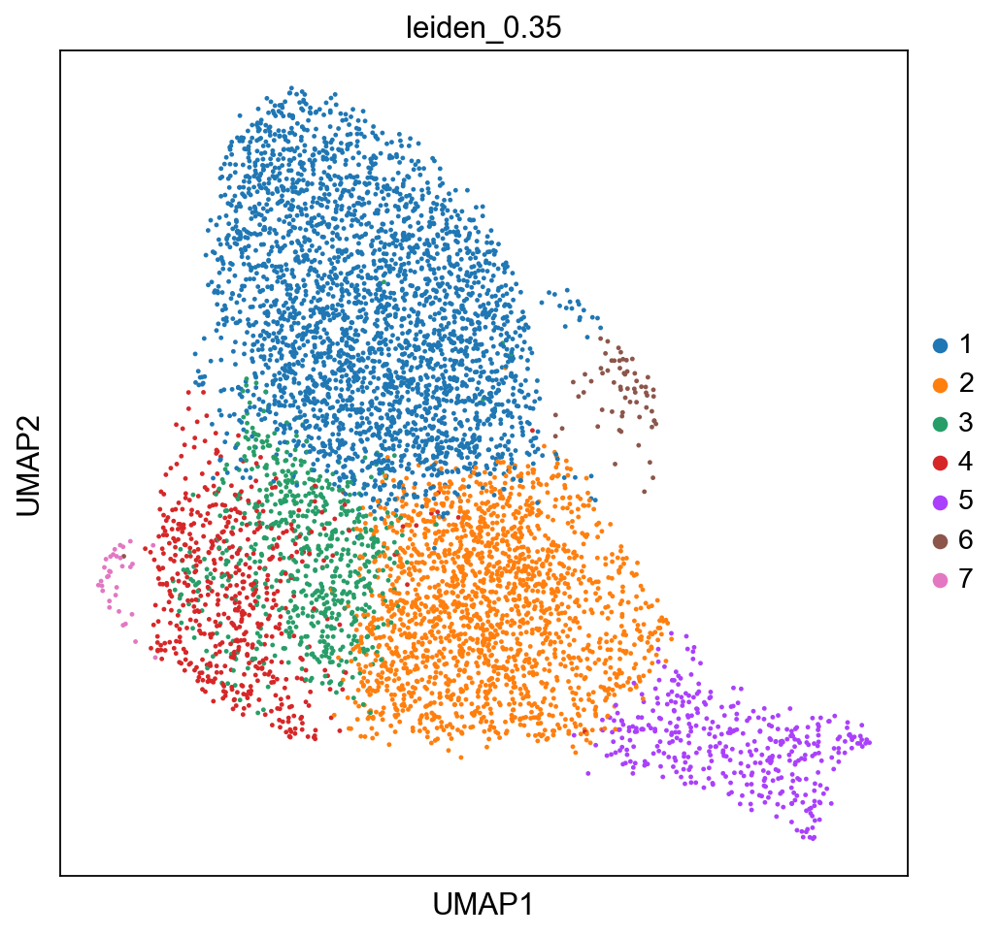

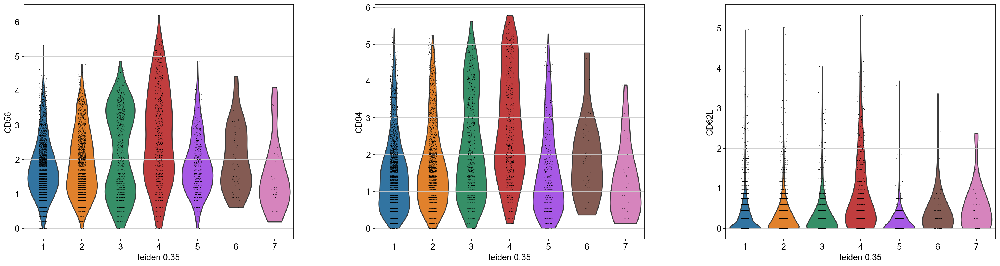

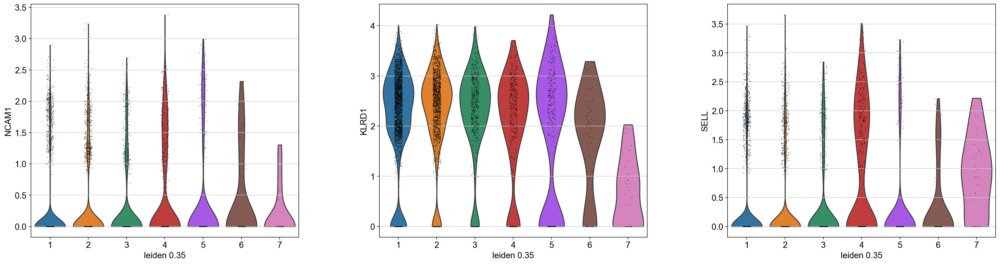

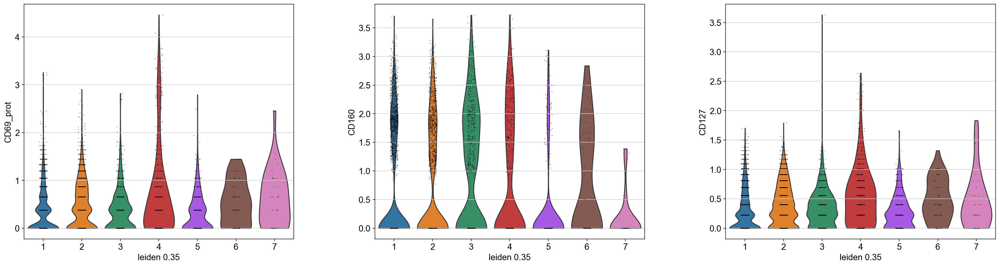

In [42]:
#Immature CD56bright proteins and corresponding RNA

sc.pl.umap(adata_nk1, color=['leiden_0.35'], ncols =3)

sc.pl.violin(adata_nk1, ['CD56', 'CD94', 'CD62L'], groupby='leiden_0.35')
sc.pl.violin(adata_nk1, ['NCAM1', 'KLRD1', 'SELL'], groupby='leiden_0.35')
sc.pl.violin(adata_nk1, ['CD69_prot', 'CD160', 'CD127'], groupby='leiden_0.35')
sc.set_figure_params(scanpy=True, fontsize=25, figsize = [7,5])

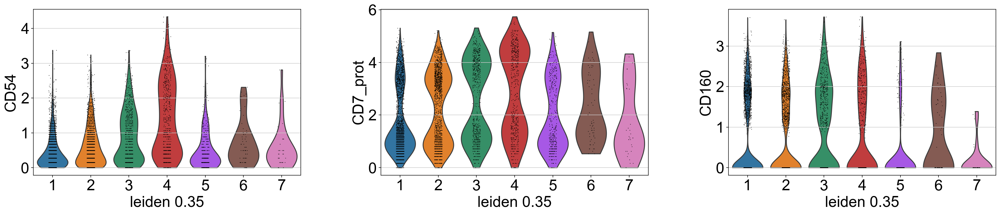

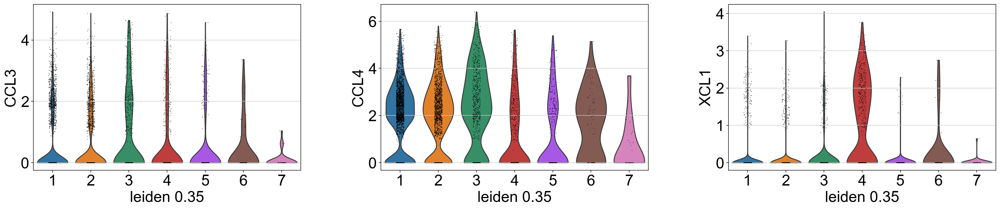

In [43]:
#tissue-resident NK, high markers, these markers identified by Catboost
sc.pl.violin(adata_nk1, ['CD54', 'CD7_prot', 'CD160'], groupby='leiden_0.35')
sc.pl.violin(adata_nk1, ['CCL3', 'CCL4', 'XCL1'], groupby='leiden_0.35')

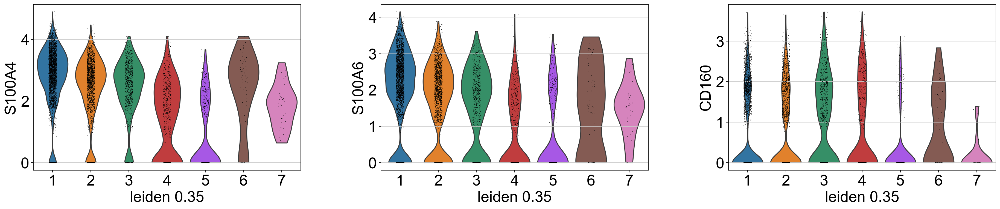

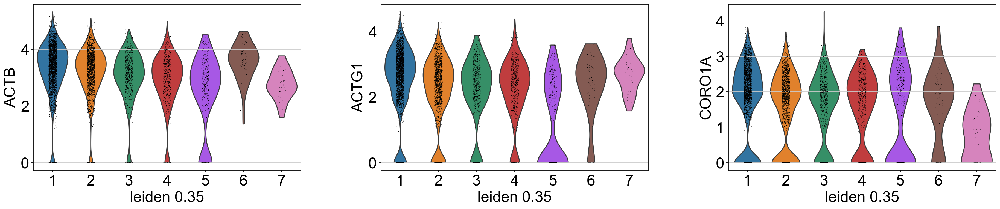

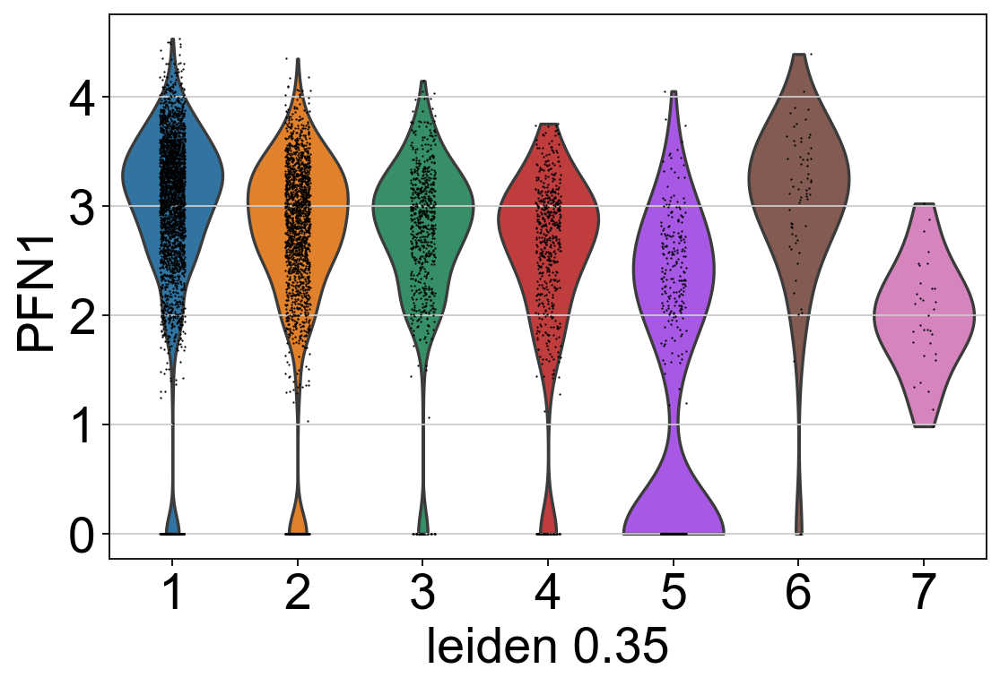

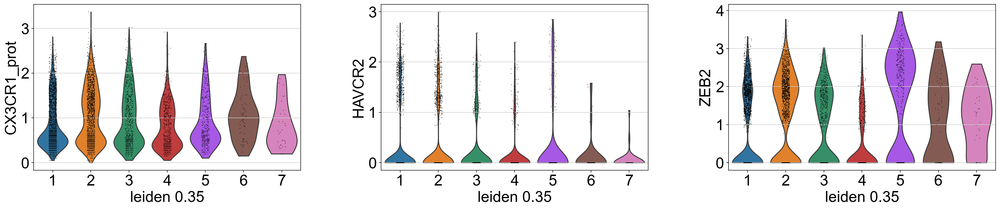

In [44]:
#Terminally differentiated (yang)

#Terminally differentiated NK
sc.pl.violin(adata_nk1, ['S100A4', 'S100A6', 'CD160'], groupby='leiden_0.35')

#Cytoskeleton markers  => CD57+ high cytotoxicity 
sc.pl.violin(adata_nk1, ['ACTB', 'ACTG1', 'CORO1A'], groupby='leiden_0.35') 
sc.pl.violin(adata_nk1, ['PFN1'], groupby='leiden_0.35')

# CX3CR1, HAVCR2 (TIM-3), and ZEB2 

sc.pl.violin(adata_nk1, ['CX3CR1_prot', 'HAVCR2', 'ZEB2'], groupby='leiden_0.35')

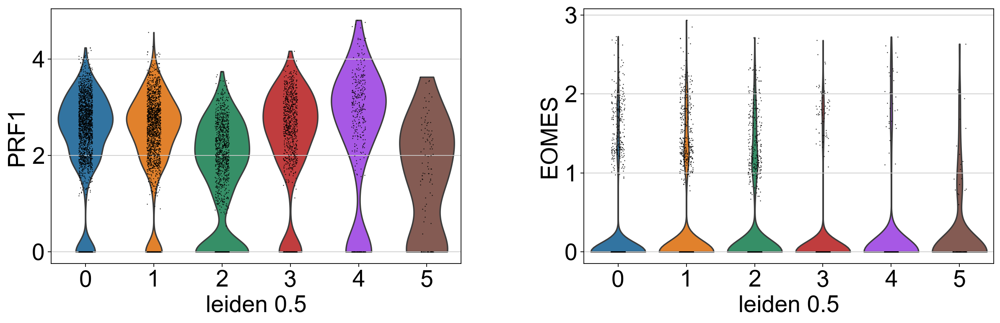

In [45]:
sc.pl.violin(adata_nk1, ['PRF1', 'EOMES'], groupby='leiden_0.5') 

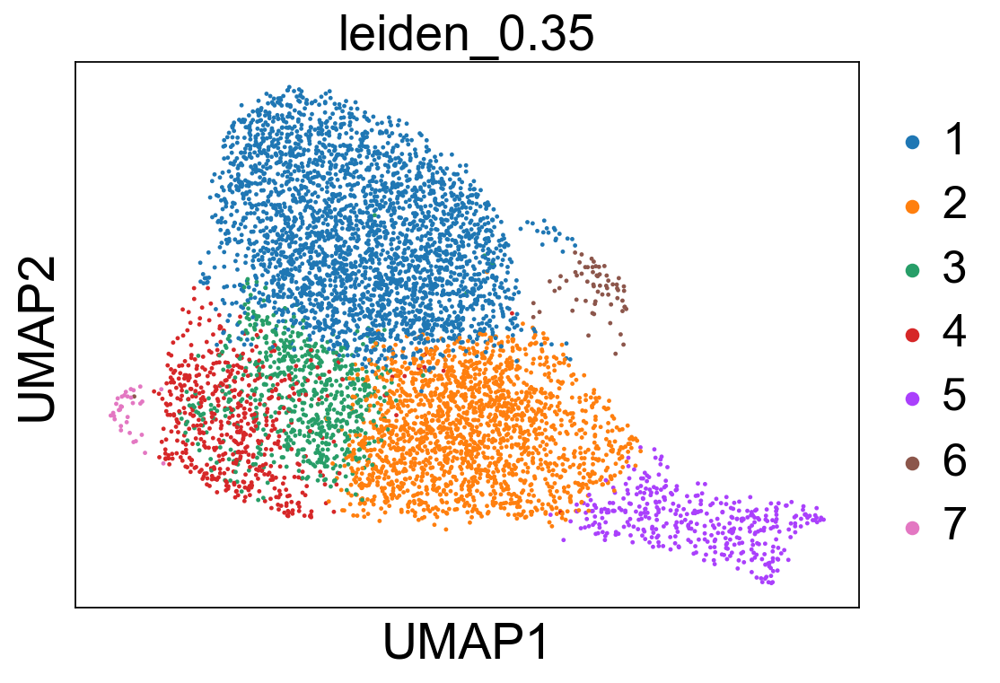

In [46]:
sc.pl.umap(adata_nk1, color=['leiden_0.35'], ncols =3)


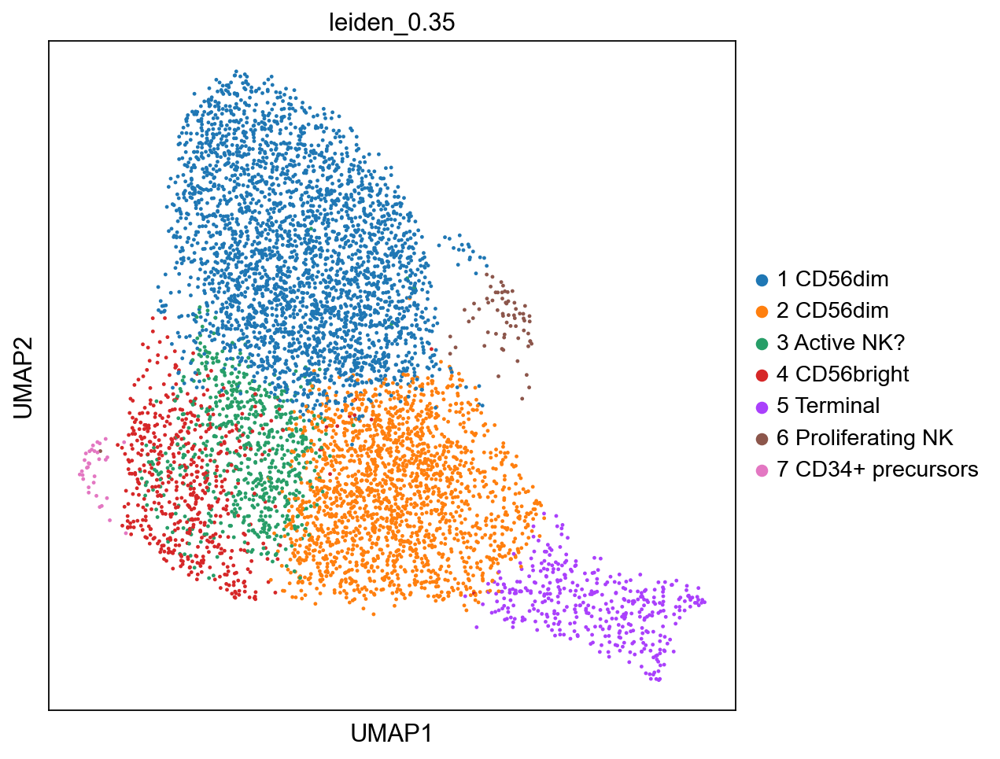

In [47]:
sc.set_figure_params(figsize=(7, 7))
new_cluster_names = [
    '1 CD56dim', '2 CD56dim',
    '3 Active NK?', '4 CD56bright',
    '5 Terminal', '6 Proliferating NK', '7 CD34+ precursors']

adata_nk1.rename_categories('leiden_0.35', new_cluster_names)

#Latent

sc.pl.umap(adata_nk1, color=['leiden_0.35'])

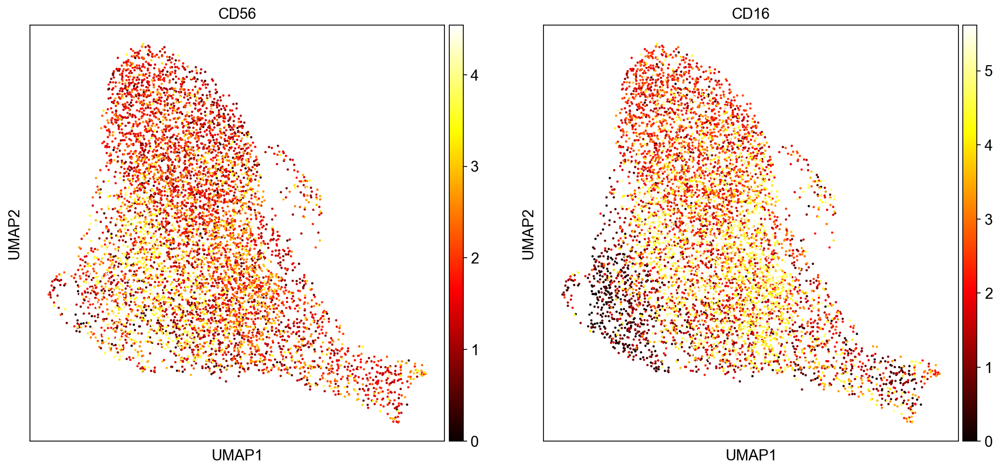

In [48]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(adata_nk1, color = ['CD56', 'CD16'] , vmax="p99", color_map = 'hot', ncols=2)


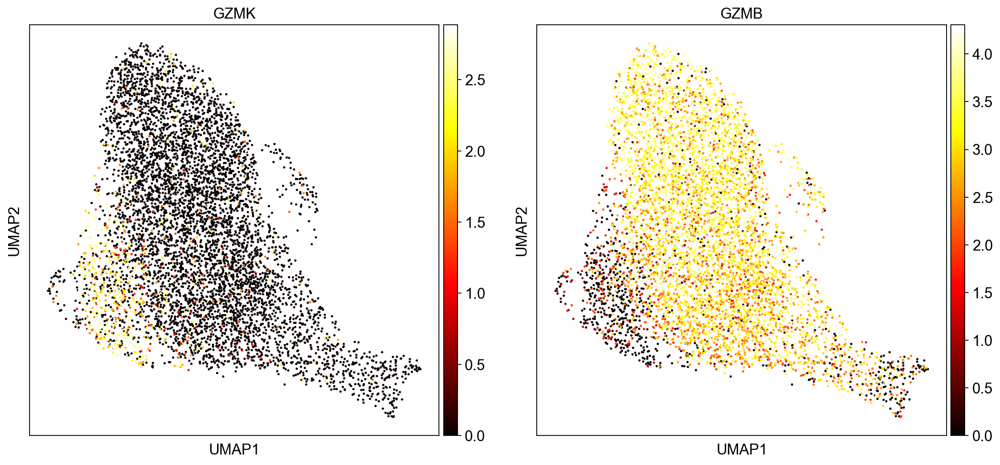

In [49]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(adata_nk1, color = ['GZMK', 'GZMB'] , vmax="p99", color_map = 'hot', ncols=2)


## Proportion plots

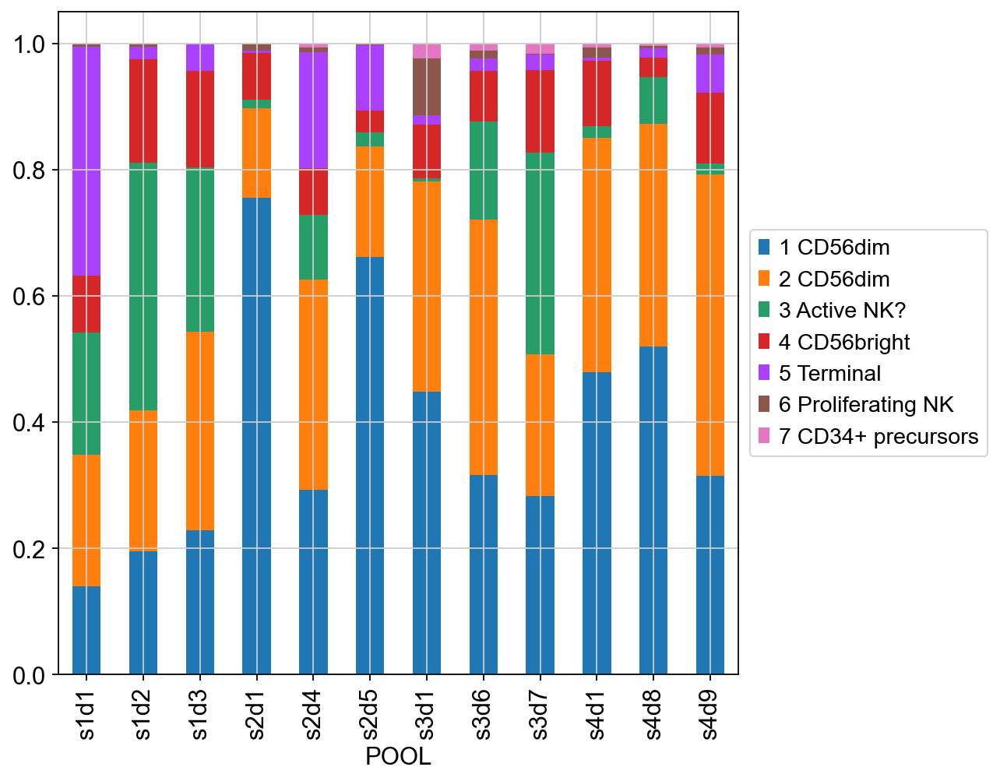

In [64]:
tmp = pd.crosstab(adata_nk1.obs['POOL'], adata_nk1.obs['leiden_0.35'], normalize='index')
tmp.plot.bar(stacked=True).legend(loc='upper right')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))